#Convolutional Neural Network Feature extraction and Analysis

###  Importing packages

In [1]:
import numpy as np
from tensorflow import keras
import tensorflow as tf
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions, VGG16
from tensorflow.keras.models import Model


import timeit

import warnings
warnings.filterwarnings('ignore')

### Preparing Dataset

In [2]:
batch_size = 32
num_classes = 10
epochs = 5

# input image dimensions
img_rows, img_cols = 28, 28
mnist = mnist = tf.keras.datasets.mnist
# the data, shuffled and split between train and test sets
(x_train, y_train), (x_test, y_test) = mnist.load_data()

if K.image_data_format() == 'channels_first':
    x_train = x_train.reshape(x_train.shape[0], 1, img_rows, img_cols)
    x_test = x_test.reshape(x_test.shape[0], 1, img_rows, img_cols)
    input_shape = (1, img_rows, img_cols)
else:
    x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, 1)
    x_test = x_test.reshape(x_test.shape[0], img_rows, img_cols, 1)
    input_shape = (img_rows, img_cols, 1)

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255
print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_test.shape[0], 'test samples')

# convert class vectors to binary class matrices
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)

11501568/11490434 [==============================] - 0s 0us/step
x_train shape: (60000, 28, 28, 1)
60000 train samples
10000 test samples


In [3]:
batch_size = 32
num_classes = 10
epochs = 5

# input image dimensions
img_rows, img_cols = 28, 28
mnist = mnist = tf.keras.datasets.mnist
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)

### Building a Model

In [4]:
model = Sequential()
model.add(Conv2D(16, kernel_size=(3, 3), activation='relu', input_shape=input_shape))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(16, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 16)        160       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 13, 13, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 11, 11, 16)        2320      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 dropout (Dropout)           (None, 5, 5, 16)          0         
                                                                 
 flatten (Flatten)           (None, 400)               0

### Model Training

In [5]:
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(),
              metrics=['accuracy'])

model.fit(x_train, y_train,
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(x_test, y_test))

Epoch 1/5
1875/1875 [==============================] - 42s 22ms/step - loss: 0.6406 - accuracy: 0.7855 - val_loss: 0.0976 - val_accuracy: 0.9720
Epoch 2/5
1875/1875 [==============================] - 32s 17ms/step - loss: 0.2991 - accuracy: 0.9040 - val_loss: 0.0663 - val_accuracy: 0.9803
Epoch 3/5
1875/1875 [==============================] - 34s 18ms/step - loss: 0.2466 - accuracy: 0.9212 - val_loss: 0.0566 - val_accuracy: 0.9835
Epoch 4/5
1875/1875 [==============================] - 32s 17ms/step - loss: 0.2244 - accuracy: 0.9286 - val_loss: 0.0511 - val_accuracy: 0.9847
Epoch 5/5
1875/1875 [==============================] - 32s 17ms/step - loss: 0.2056 - accuracy: 0.9339 - val_loss: 0.0455 - val_accuracy: 0.9861


### Testing

In [6]:
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 0.04547245800495148
Test accuracy: 0.9861000180244446


### Prediction

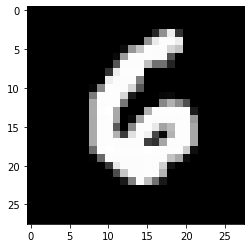

In [7]:
import pylab as plt

plt.imshow(x_test[130:131].reshape(28,28),cmap='gray')
plt.show()

In [8]:
import numpy as np
prediction = model.predict(x_test[130:131])
print('Prediction Score:\n',prediction[0])
thresholded = (prediction>0.5)*1
print('\nThresholded Score:\n',thresholded[0])
print('\nPredicted Digit:\n',np.where(thresholded == 1)[1][0])

Prediction Score:
 [1.2853141e-08 2.1251606e-11 1.1921311e-09 2.8451286e-12 2.0588358e-09
 1.8302961e-06 9.9999821e-01 4.2226609e-16 5.3088350e-08 6.2676163e-11]

Thresholded Score:
 [0 0 0 0 0 0 1 0 0 0]

Predicted Digit:
 6


Keract is a library for extracting the activation and visualize them

https://github.com/philipperemy/keract

In [9]:
!pip install keract

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Get Activation of all layers with Keract

In [10]:
from keract import get_activations
activations = get_activations(model, x_test[130:131])

Display Activation using keract

conv2d_input (1, 28, 28) 


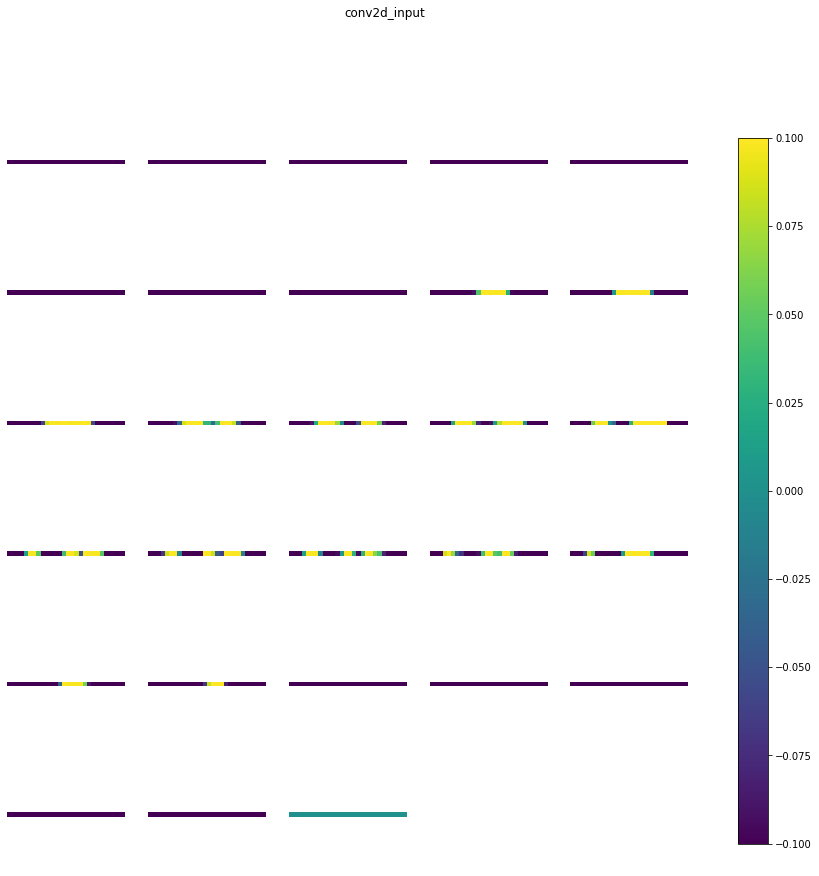

conv2d (1, 26, 26, 16) 


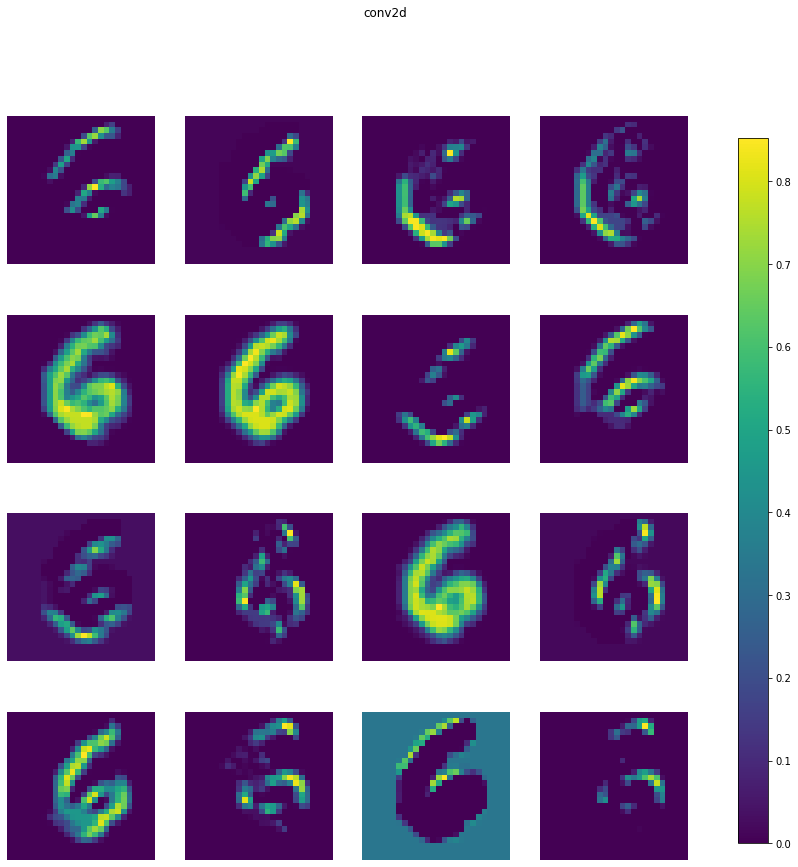

max_pooling2d (1, 13, 13, 16) 


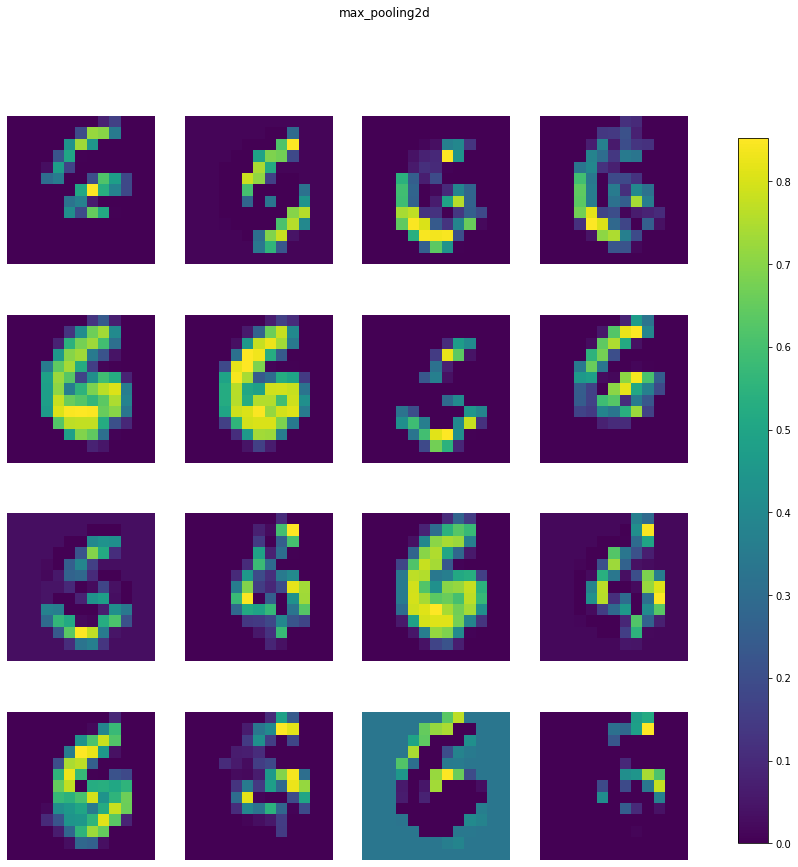

conv2d_1 (1, 11, 11, 16) 


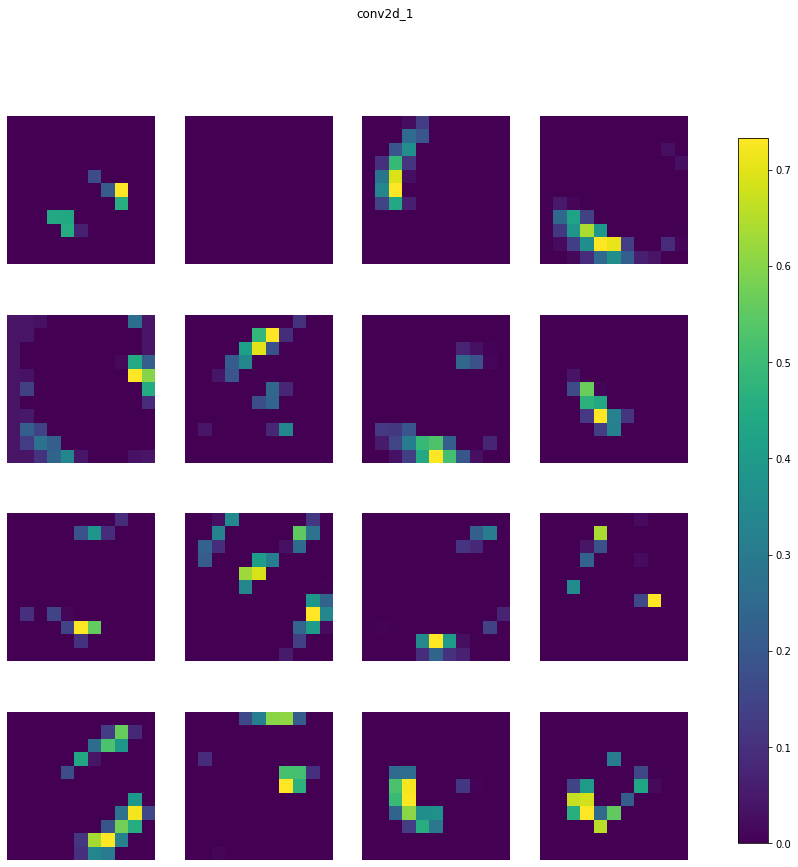

max_pooling2d_1 (1, 5, 5, 16) 


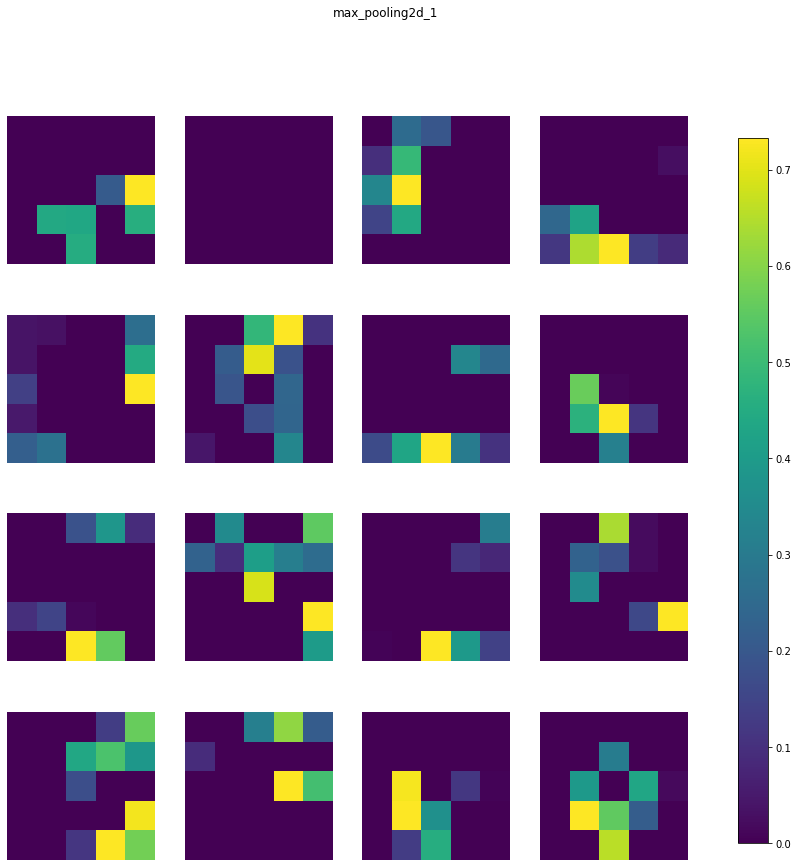

dropout (1, 5, 5, 16) 


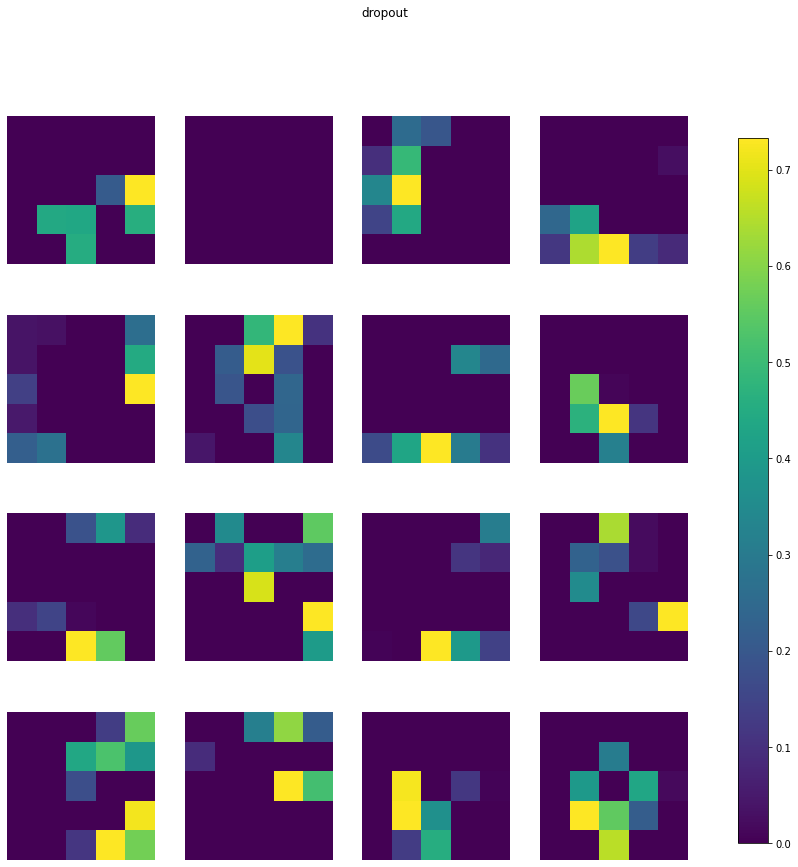

flatten (1, 400) 


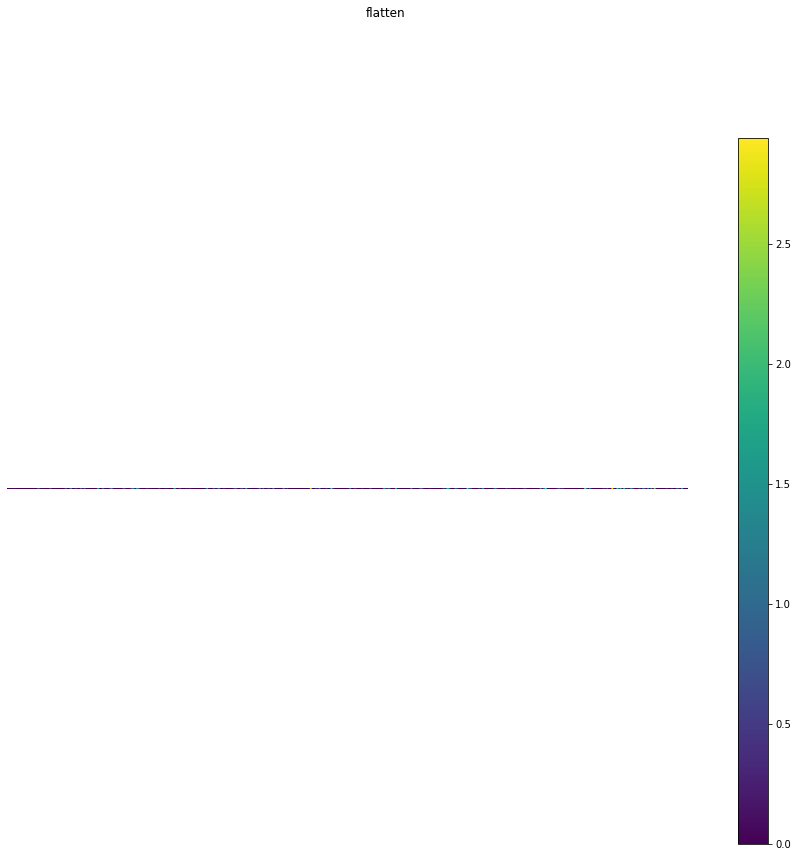

dense (1, 32) 


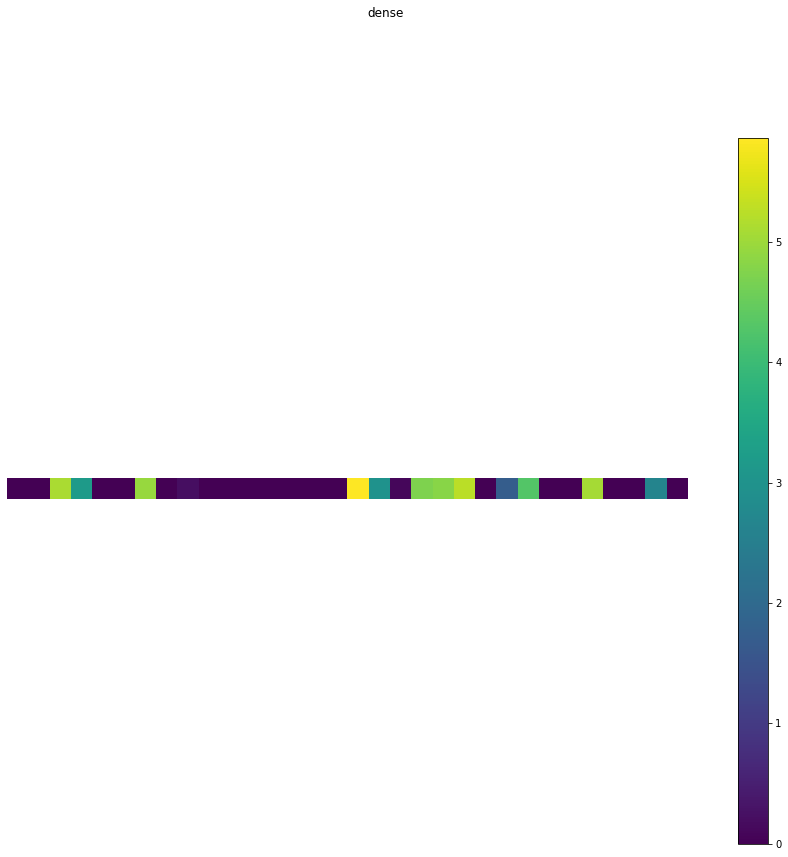

dropout_1 (1, 32) 


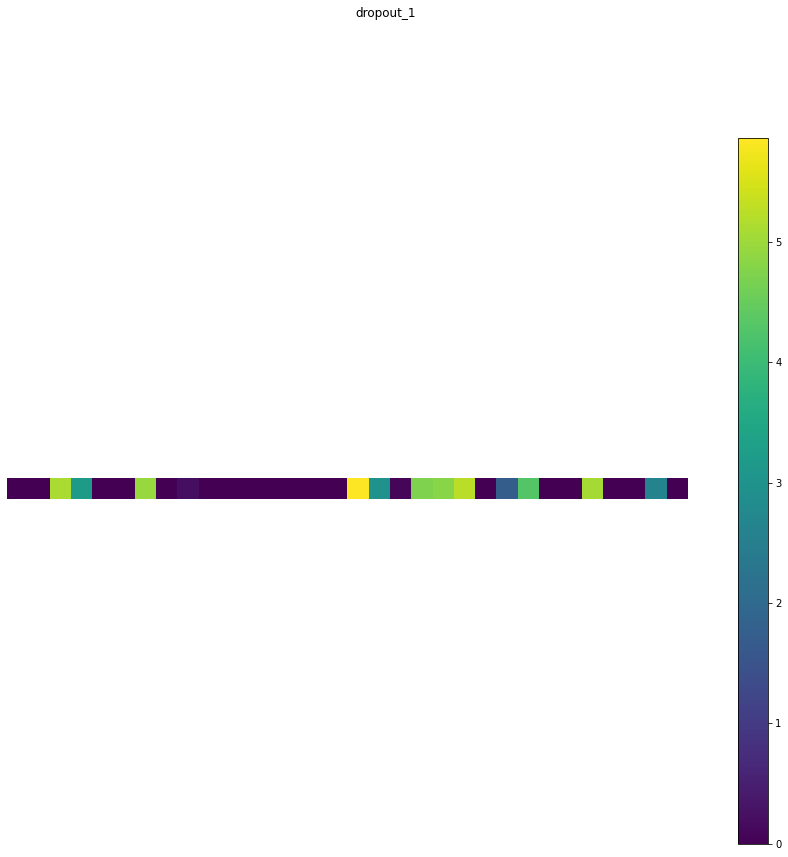

dense_1 (1, 10) 


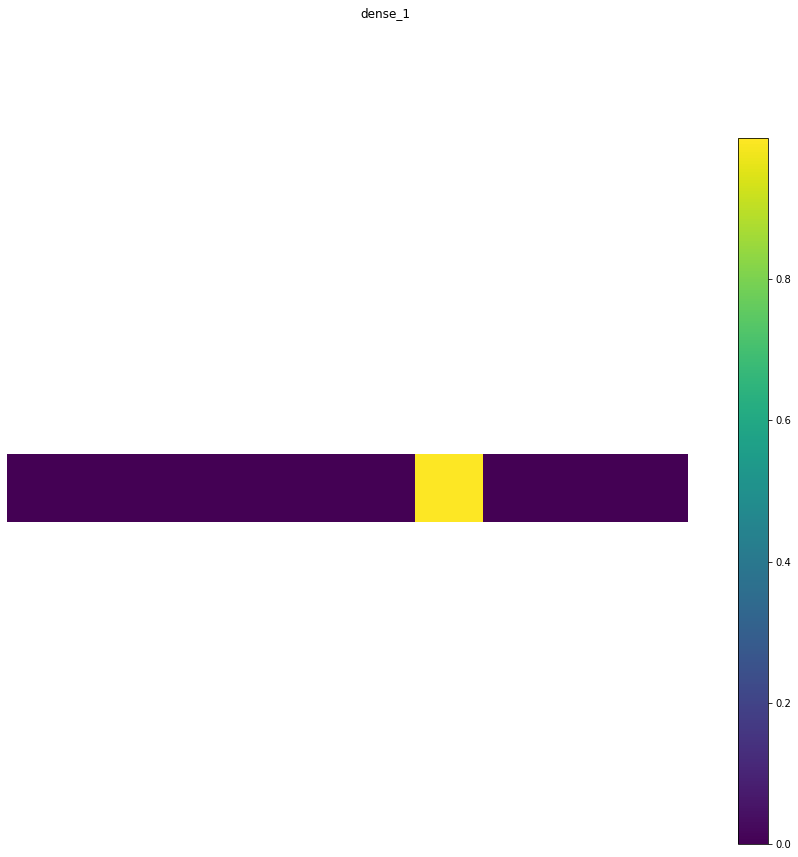

In [11]:
from keract import display_activations
display_activations(activations, save=False, fig_size=(14, 14))

# Pretrained Convolutional Neural Network

###  MobileNet Models

In [12]:
model = MobileNet(input_shape=None, alpha=0.25, depth_multiplier=1, dropout=1e-3, 
                                 include_top=True, weights='imagenet', input_tensor=None, pooling=None, classes=1000)

model.summary()

2121728/2108140 [==============================] - 0s 0us/step
Model: "mobilenet_0.25_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 8)       216       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 8)      32        
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 8)       0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 8)      72        
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 8)  

In [13]:
!wget https://github.com/mishravipul/AdvanceDeepLearning/raw/master/Cat.jpg

--2022-10-05 07:32:07--  https://github.com/mishravipul/AdvanceDeepLearning/raw/master/Cat.jpg
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/mishravipul/AdvanceDeepLearning/master/Cat.jpg [following]
--2022-10-05 07:32:08--  https://raw.githubusercontent.com/mishravipul/AdvanceDeepLearning/master/Cat.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5217 (5.1K) [image/jpeg]
Saving to: ‘Cat.jpg’

Cat.jpg             100%[===================>]   5.09K  --.-KB/s    in 0s      

2022-10-05 07:32:08 (46.4 MB/s) - ‘Cat.jpg’ saved [5217/5217]



###  Classify images

In [14]:
# Write the image name below

img_path = 'Cat.jpg'
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

preds = model.predict(x)
print('Predicted:\n', decode_predictions(preds))

49152/35363 [=========================================] - 0s 0us/step
Predicted:
 [[('n03325584', 'feather_boa', 0.06737985), ('n03483316', 'hand_blower', 0.043690175), ('n04116512', 'rubber_eraser', 0.038216047), ('n02977058', 'cash_machine', 0.031845916), ('n04209239', 'shower_curtain', 0.03124271)]]


###  Extract CNN features

In [15]:
features = model.predict(x)
print('\nFeature Shape:\n',features.shape)
print('\nFeatures:\n',features)


Feature Shape:
 (1, 1000)

Features:
 [[2.70216276e-07 2.73807545e-05 1.57188115e-05 4.45762771e-06
  1.98064354e-05 9.35084358e-07 2.88373417e-06 8.45341674e-07
  4.98199199e-07 4.05326750e-09 1.11307543e-07 1.23760515e-07
  3.21168386e-07 5.05195999e-07 2.10400412e-06 2.15661757e-07
  5.86508168e-06 4.43142835e-06 4.85484497e-06 5.53150994e-06
  4.35006235e-08 1.18134517e-06 2.19387107e-06 8.13624592e-06
  4.01946090e-06 4.11301016e-06 2.45078227e-05 1.50986889e-04
  2.38499961e-05 7.15256756e-05 4.84270856e-07 2.11754042e-07
  5.09391248e-06 9.09320818e-07 6.21725974e-07 2.44426087e-06
  2.31370286e-05 1.04194360e-05 3.82480539e-05 7.24643041e-06
  6.95142626e-06 2.95509599e-05 7.69593680e-06 2.14674728e-07
  1.05550534e-04 3.38906648e-05 3.32513446e-05 1.18549281e-06
  9.59684812e-08 2.31259560e-06 1.31886845e-05 6.03555709e-05
  1.35062746e-05 1.54568697e-04 1.83295697e-06 5.96694747e-07
  3.15273210e-05 1.44844236e-07 1.09603559e-06 3.67418096e-07
  5.37215328e-06 4.97989731e-07

In [16]:
##find name of layer

model_minimal = Model(inputs=model.input, outputs=model.get_layer('conv1_relu').output)

conv_dw_2_relu_features = model_minimal.predict(x)
print('Features of conv_dw_2_relu:',conv_dw_2_relu_features.shape)

Features of conv_dw_2_relu: (1, 112, 112, 8)


In [17]:
# write your code
np.save('extracted cnn features', conv_dw_2_relu_features)

### Visualize feature using kerasact

In [18]:
from keract import get_activations
activations = get_activations(model, x)

input_1 (1, 224, 224, 3) 


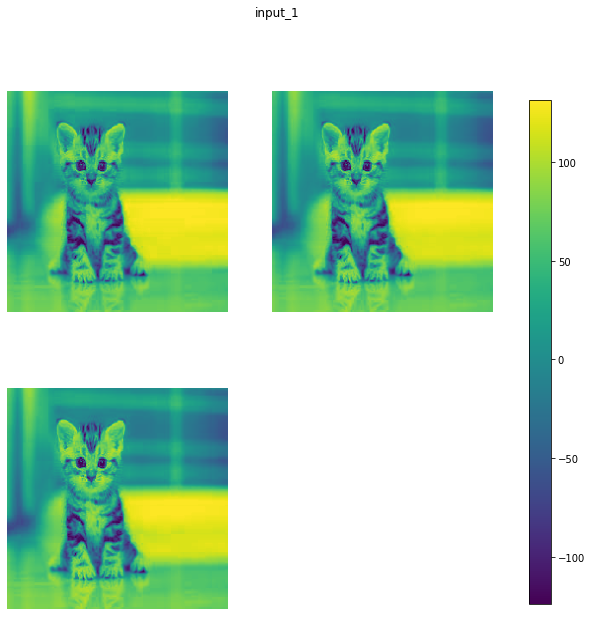

conv1 (1, 112, 112, 8) 


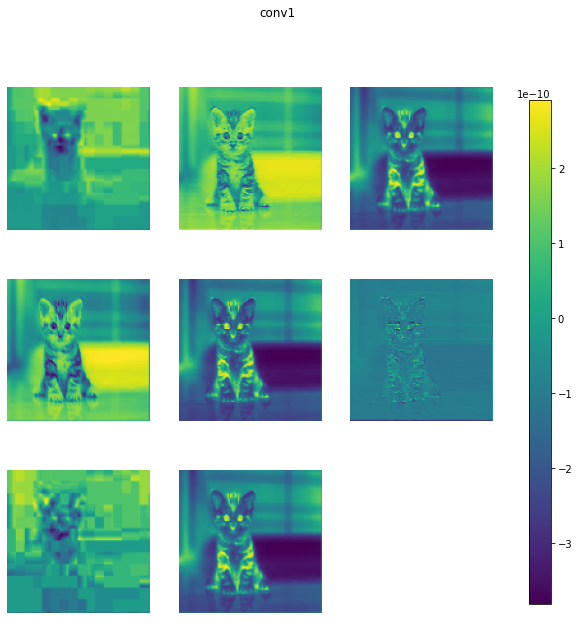

conv1_bn (1, 112, 112, 8) 


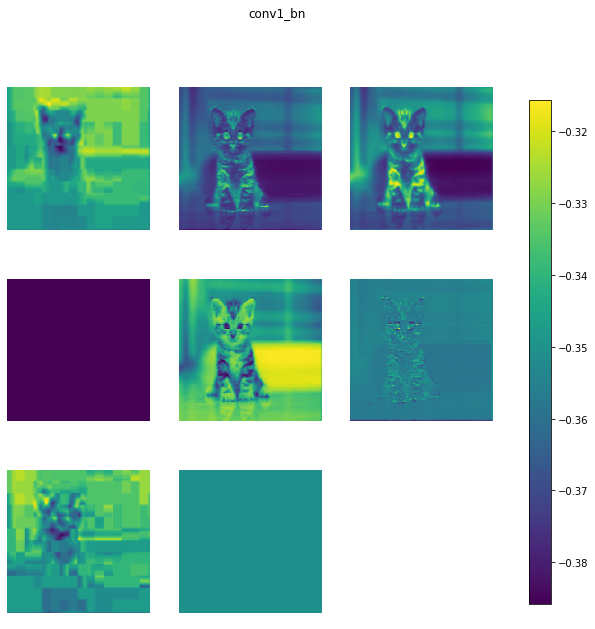

conv1_relu (1, 112, 112, 8) 


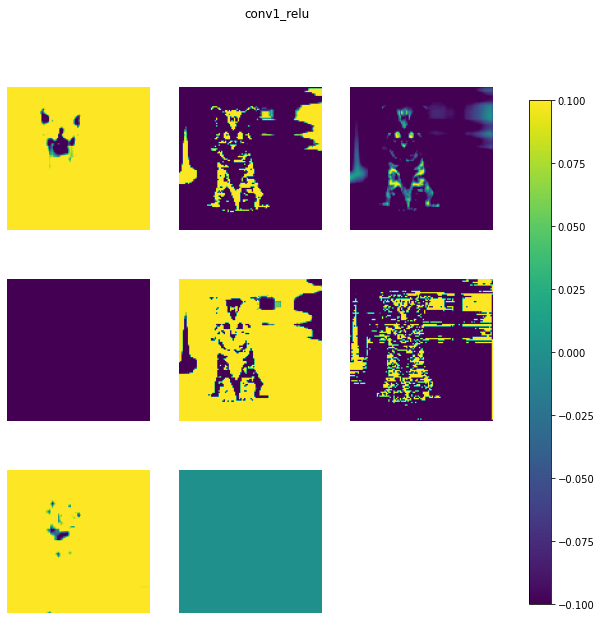

conv_dw_1 (1, 112, 112, 8) 


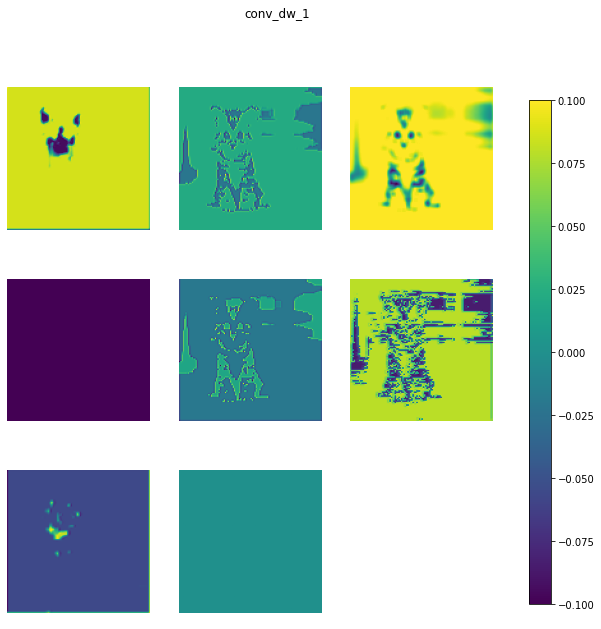

conv_dw_1_bn (1, 112, 112, 8) 


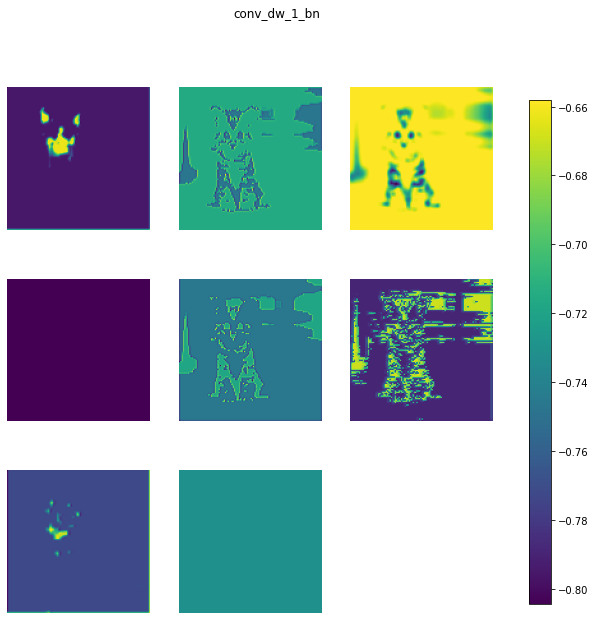

conv_dw_1_relu (1, 112, 112, 8) 


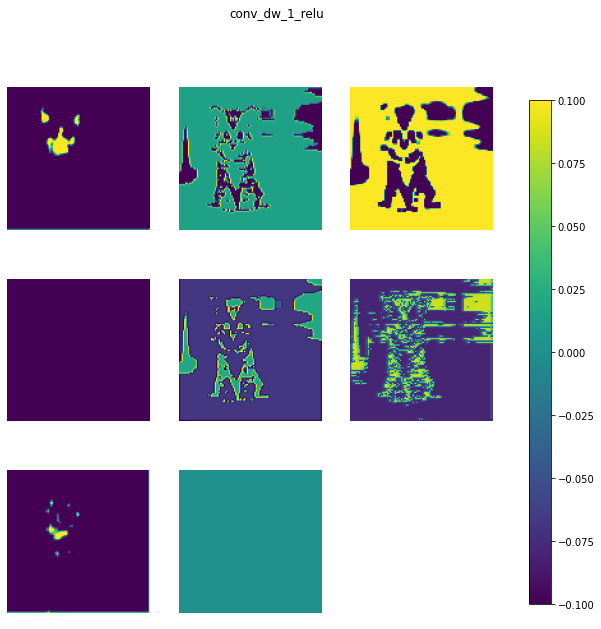

conv_pw_1 (1, 112, 112, 16) 


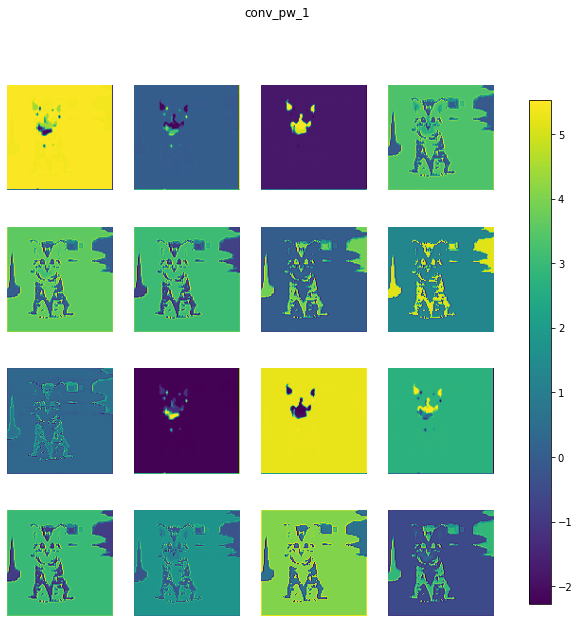

conv_pw_1_bn (1, 112, 112, 16) 


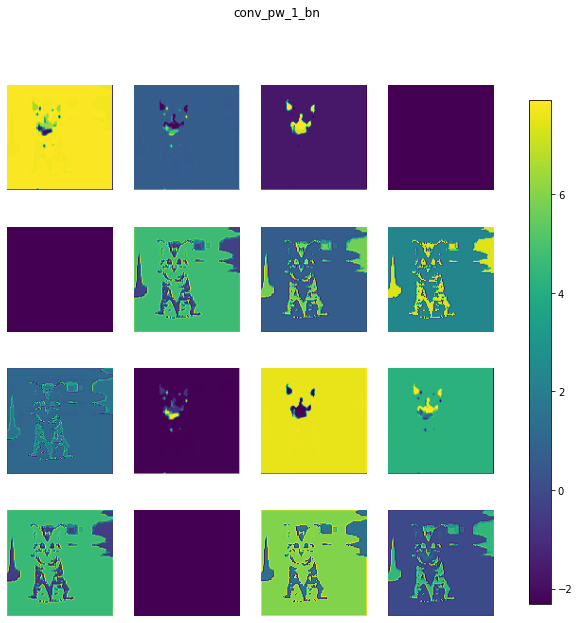

conv_pw_1_relu (1, 112, 112, 16) 


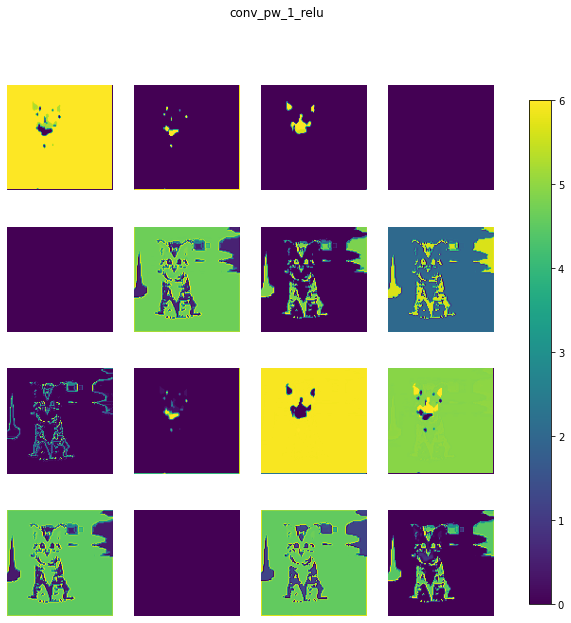

conv_pad_2 (1, 113, 113, 16) 


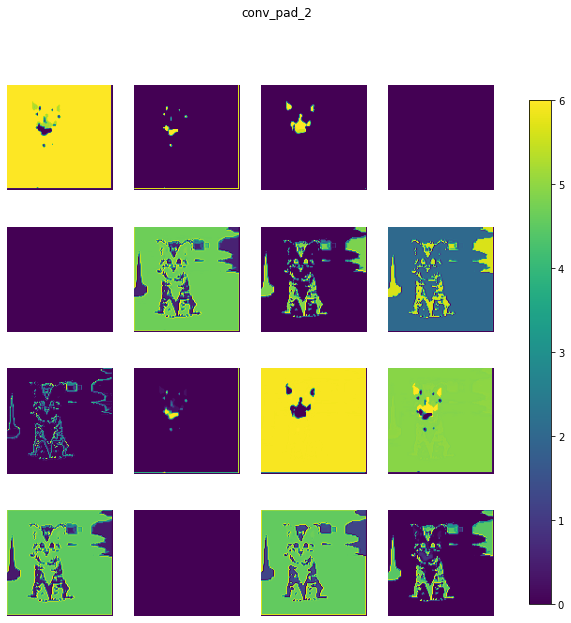

conv_dw_2 (1, 56, 56, 16) 


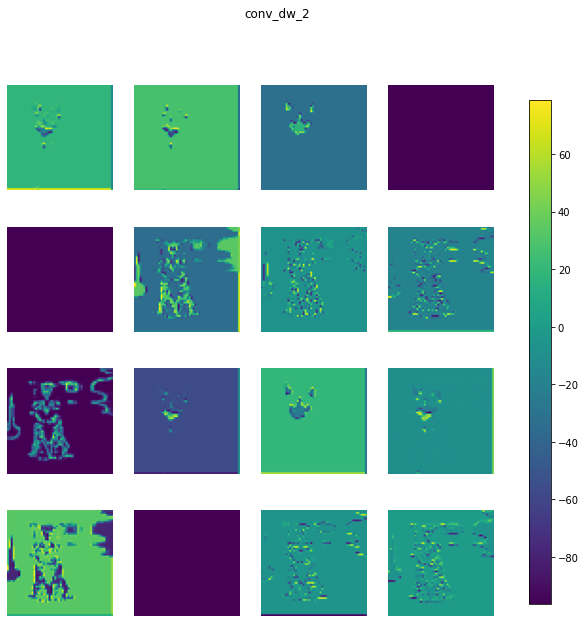

conv_dw_2_bn (1, 56, 56, 16) 


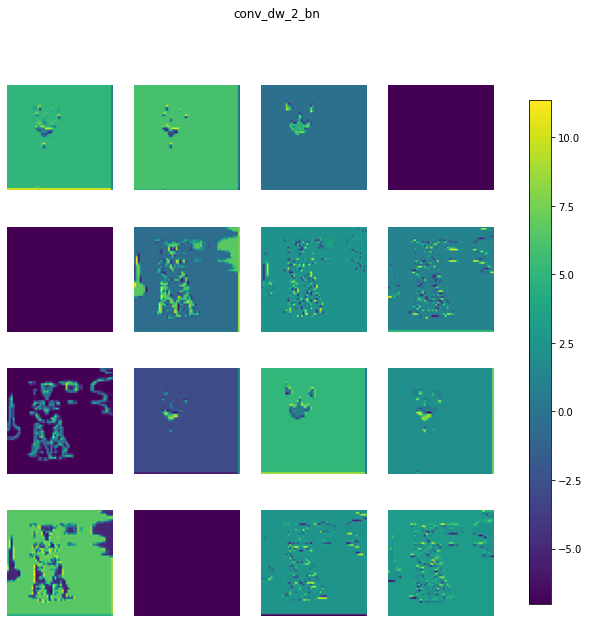

conv_dw_2_relu (1, 56, 56, 16) 


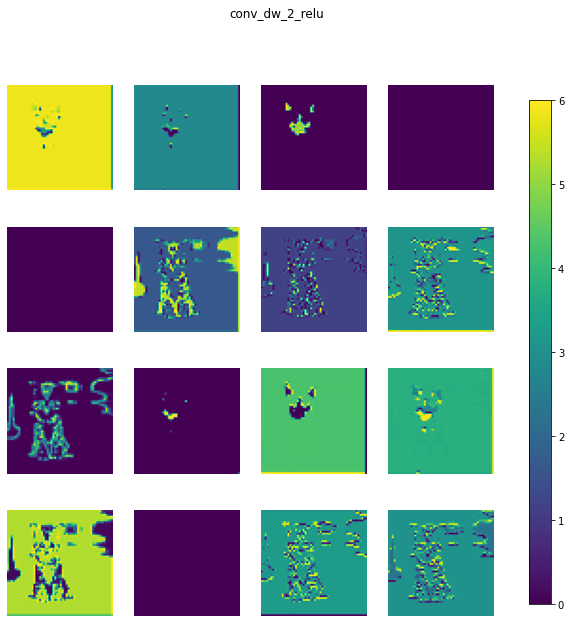

conv_pw_2 (1, 56, 56, 32) 


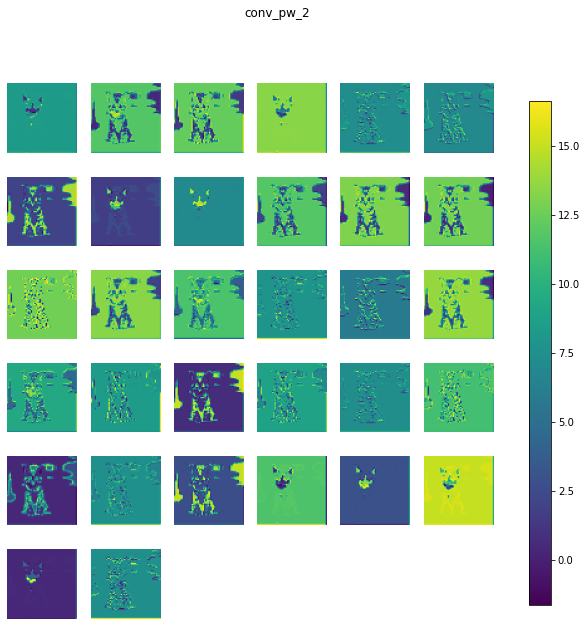

conv_pw_2_bn (1, 56, 56, 32) 


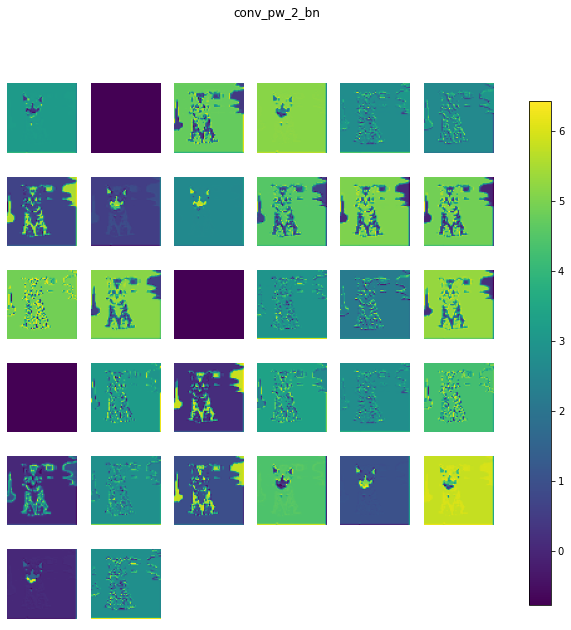

conv_pw_2_relu (1, 56, 56, 32) 


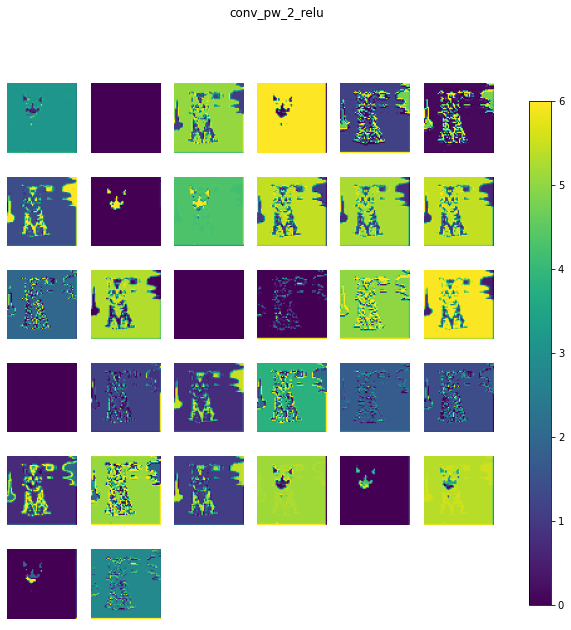

conv_dw_3 (1, 56, 56, 32) 


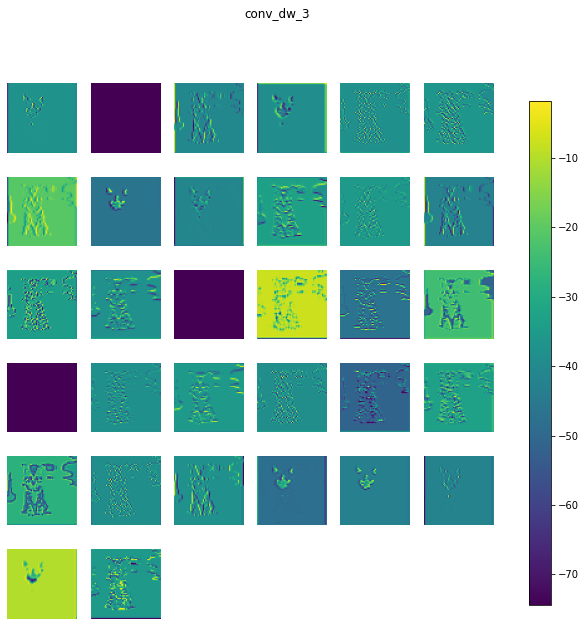

conv_dw_3_bn (1, 56, 56, 32) 


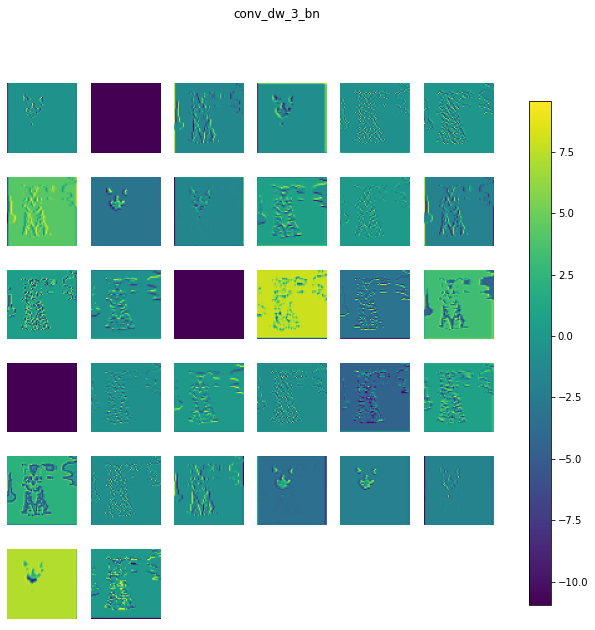

conv_dw_3_relu (1, 56, 56, 32) 


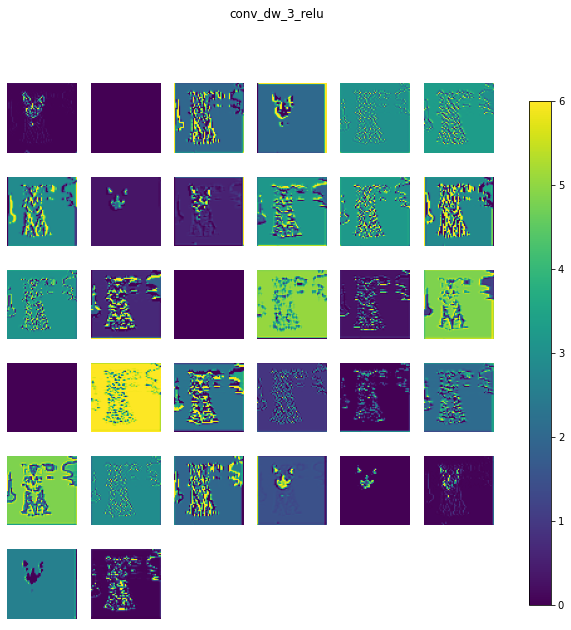

conv_pw_3 (1, 56, 56, 32) 


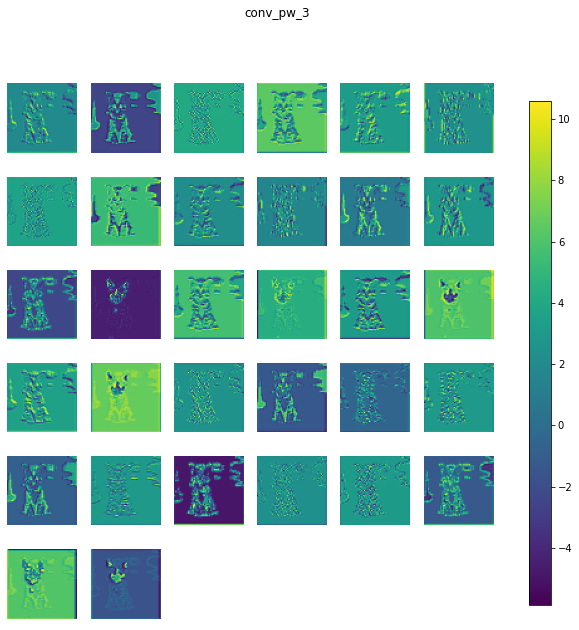

conv_pw_3_bn (1, 56, 56, 32) 


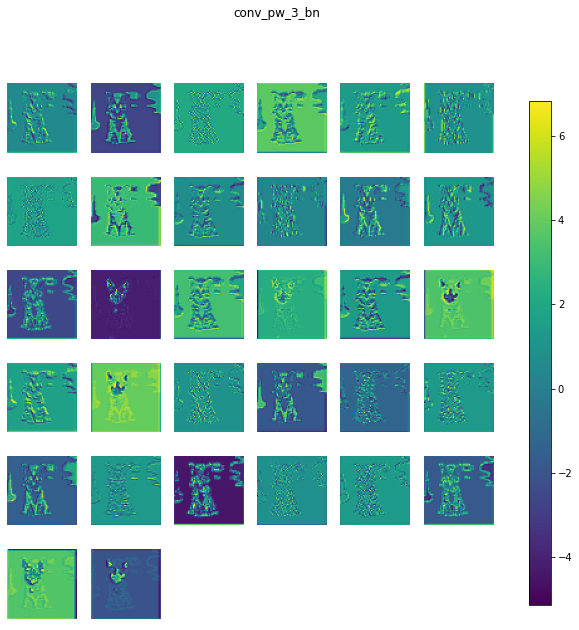

conv_pw_3_relu (1, 56, 56, 32) 


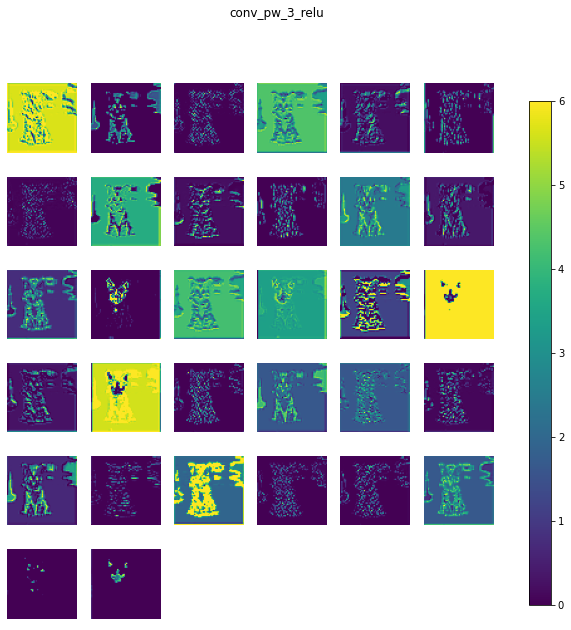

conv_pad_4 (1, 57, 57, 32) 


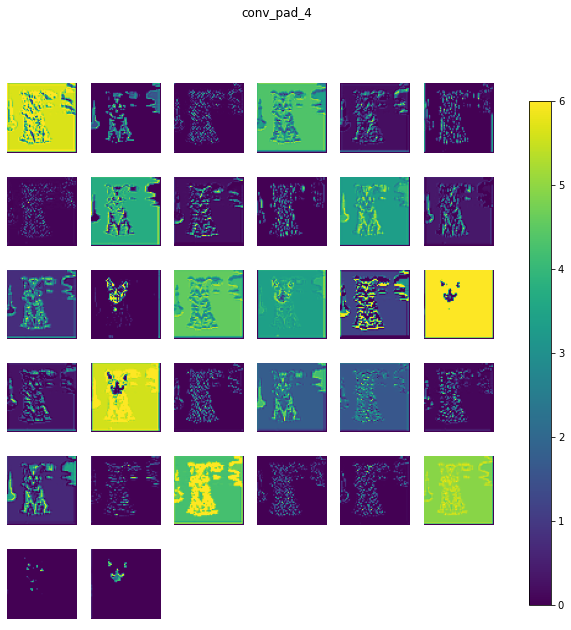

conv_dw_4 (1, 28, 28, 32) 


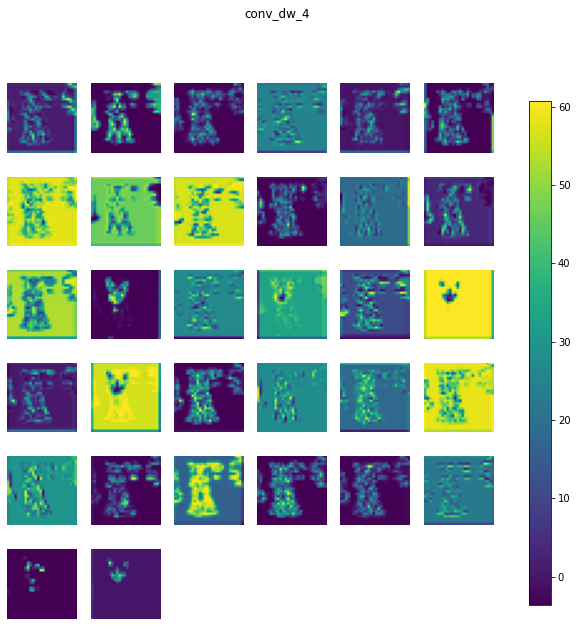

conv_dw_4_bn (1, 28, 28, 32) 


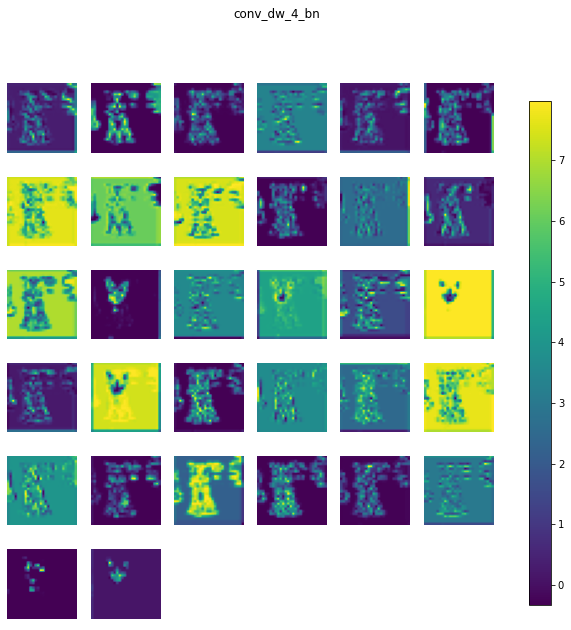

conv_dw_4_relu (1, 28, 28, 32) 


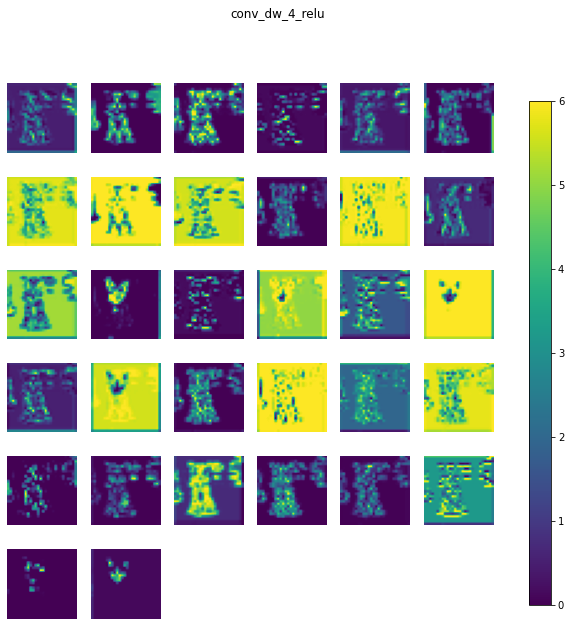

conv_pw_4 (1, 28, 28, 64) 


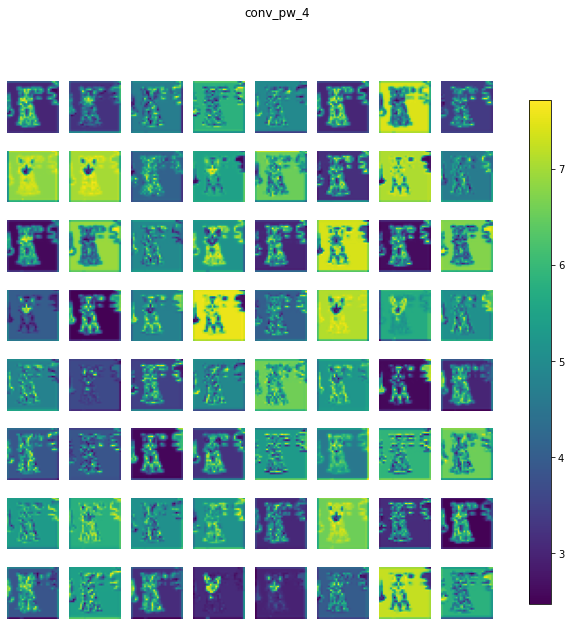

conv_pw_4_bn (1, 28, 28, 64) 


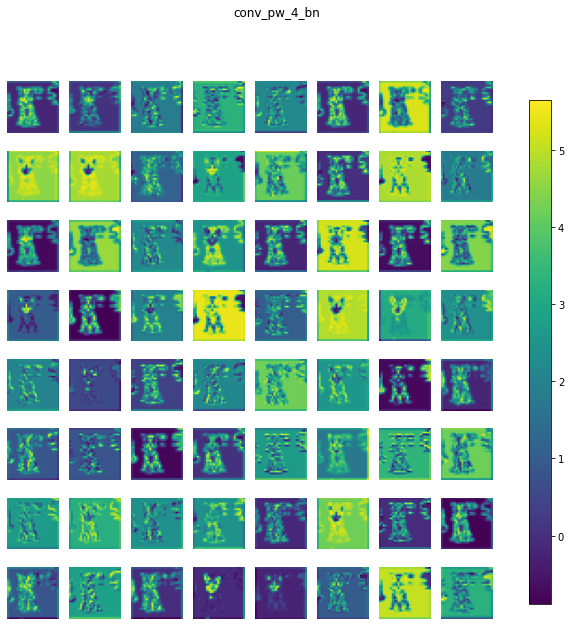

conv_pw_4_relu (1, 28, 28, 64) 


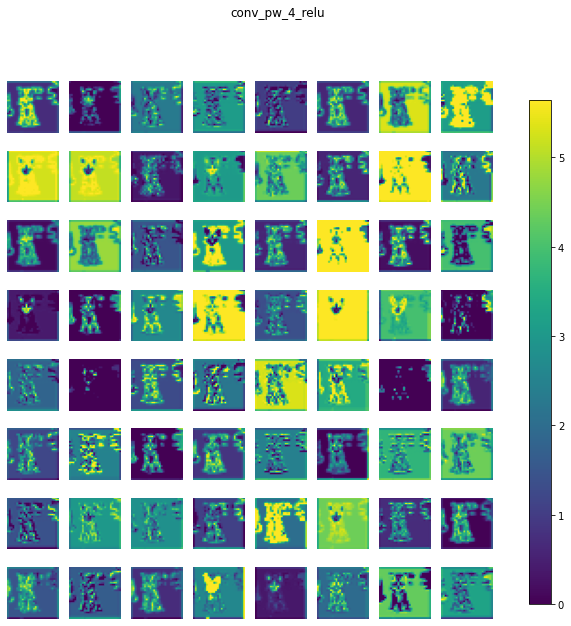

conv_dw_5 (1, 28, 28, 64) 


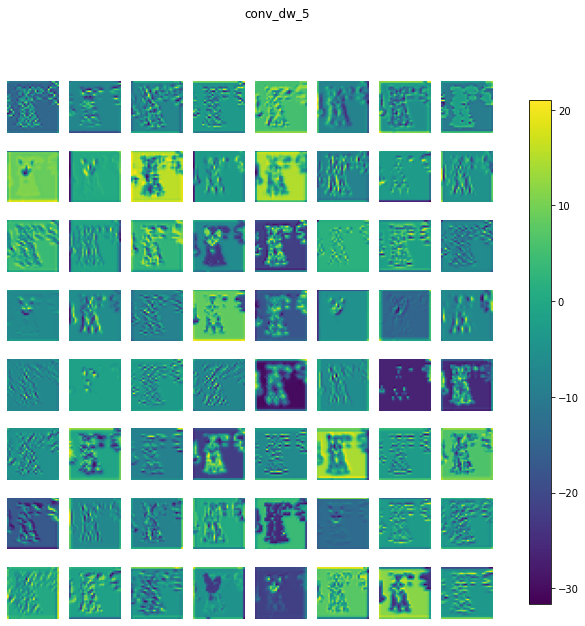

conv_dw_5_bn (1, 28, 28, 64) 


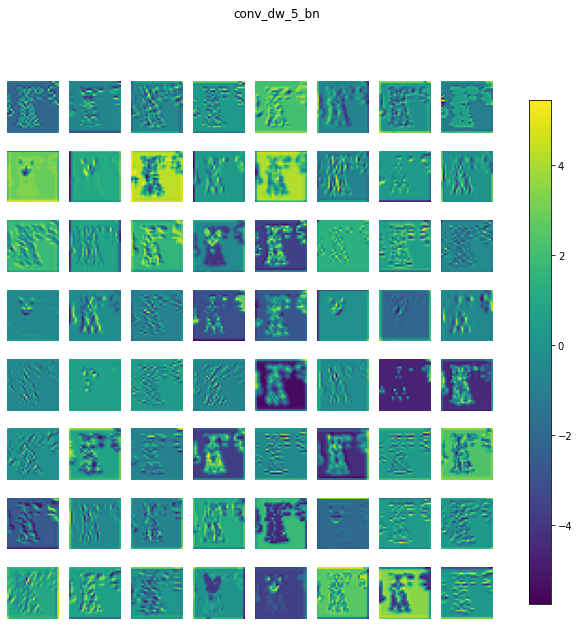

conv_dw_5_relu (1, 28, 28, 64) 


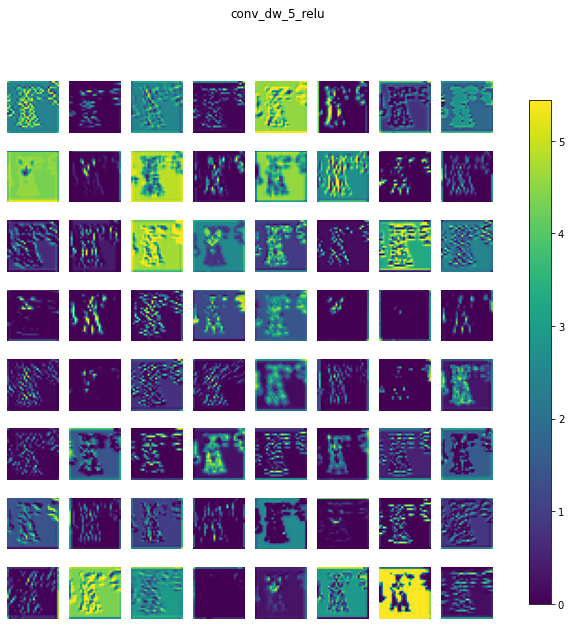

conv_pw_5 (1, 28, 28, 64) 


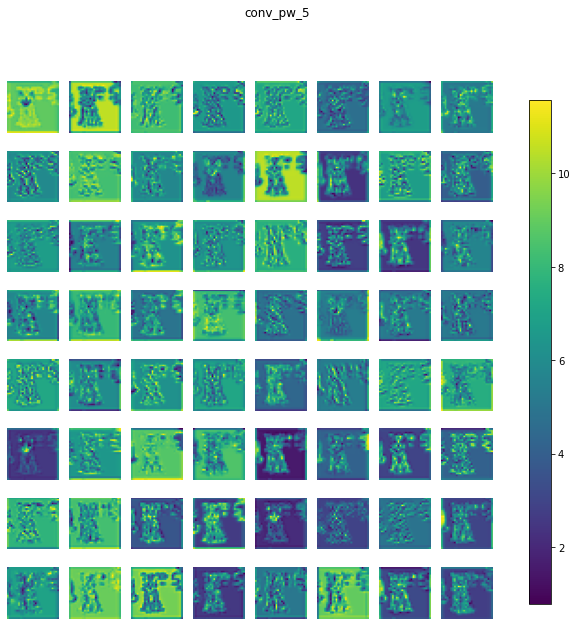

conv_pw_5_bn (1, 28, 28, 64) 


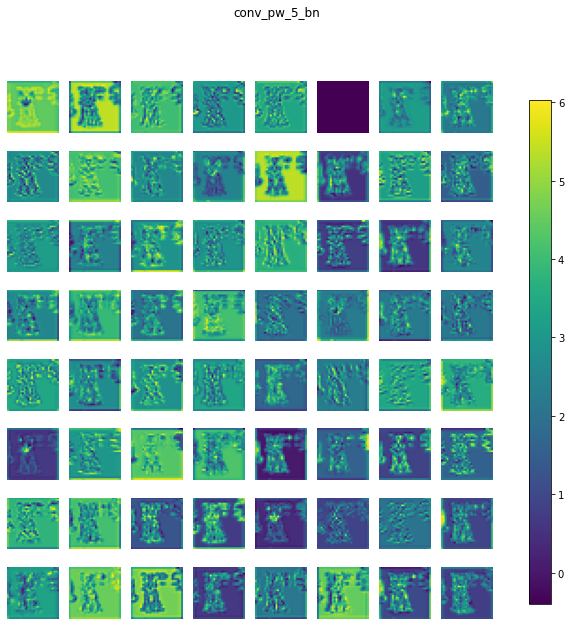

conv_pw_5_relu (1, 28, 28, 64) 


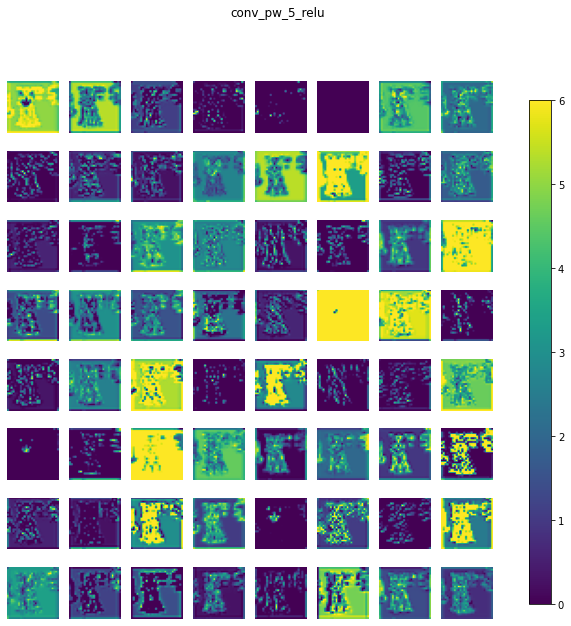

conv_pad_6 (1, 29, 29, 64) 


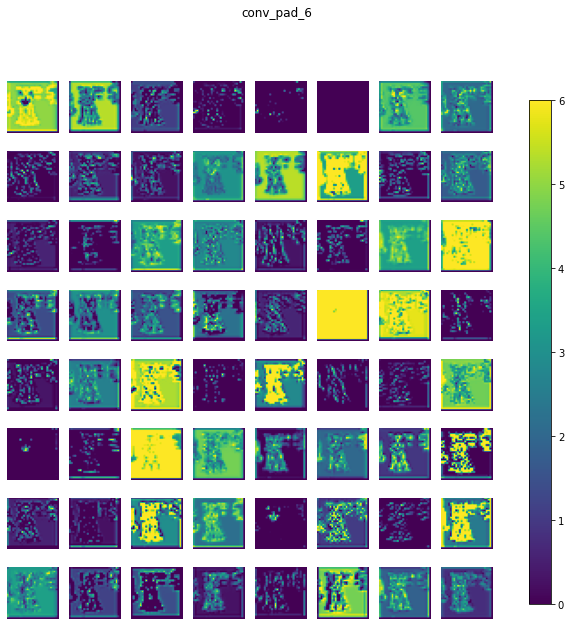

conv_dw_6 (1, 14, 14, 64) 


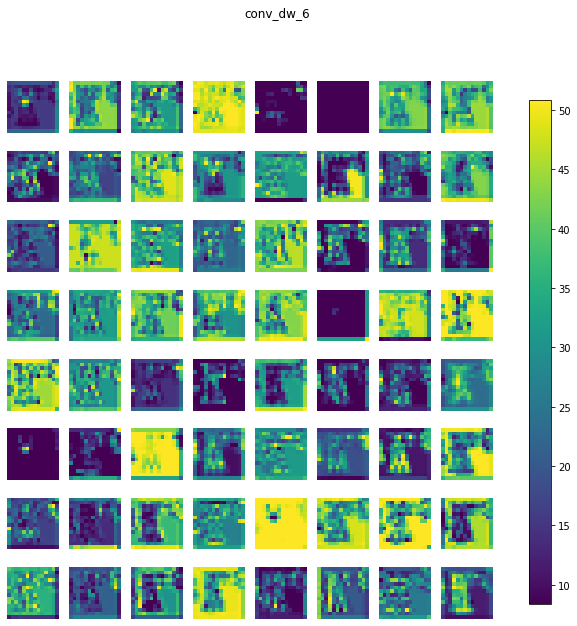

conv_dw_6_bn (1, 14, 14, 64) 


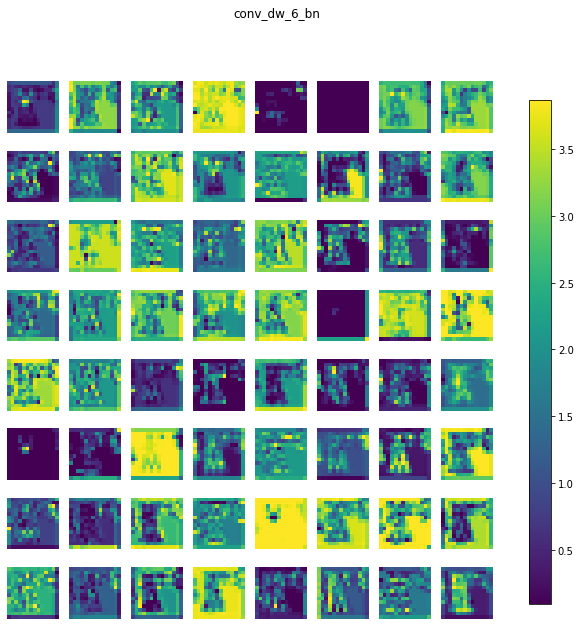

conv_dw_6_relu (1, 14, 14, 64) 


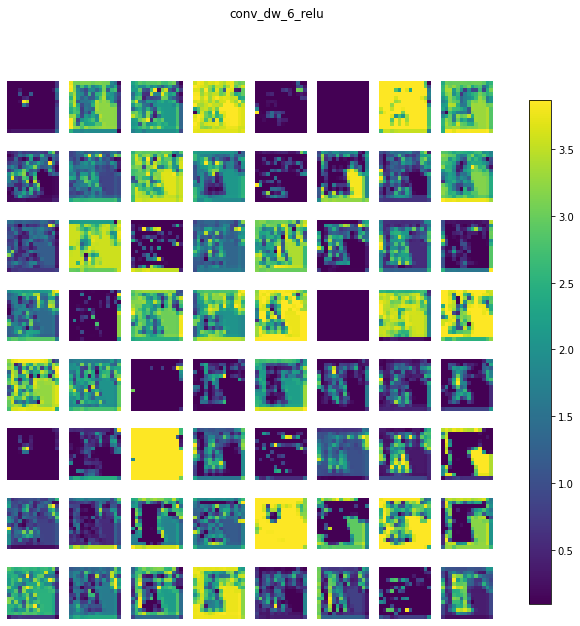

conv_pw_6 (1, 14, 14, 128) 


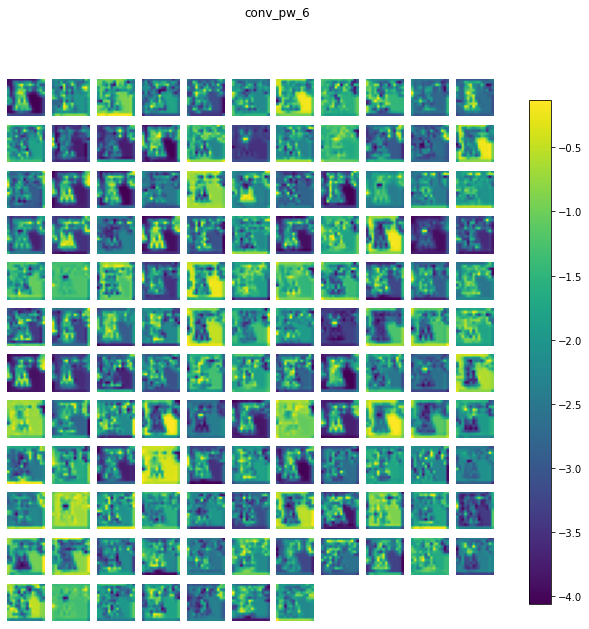

conv_pw_6_bn (1, 14, 14, 128) 


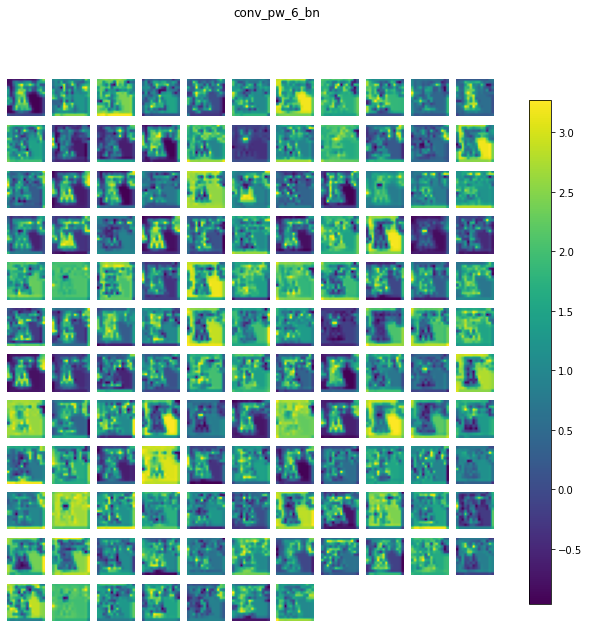

conv_pw_6_relu (1, 14, 14, 128) 


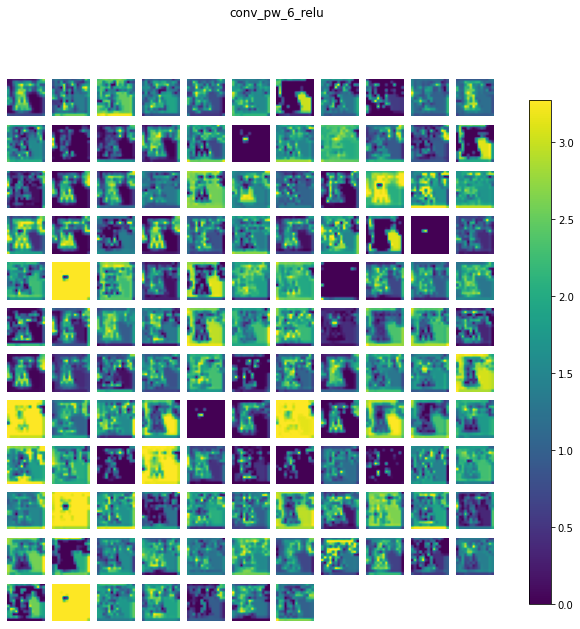

conv_dw_7 (1, 14, 14, 128) 


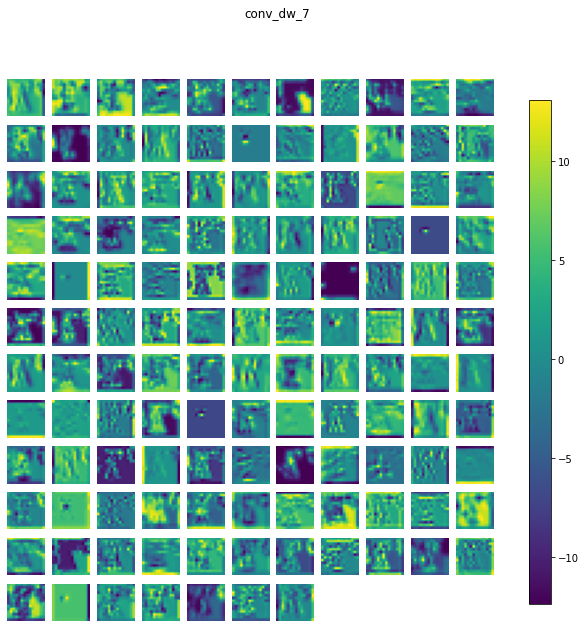

conv_dw_7_bn (1, 14, 14, 128) 


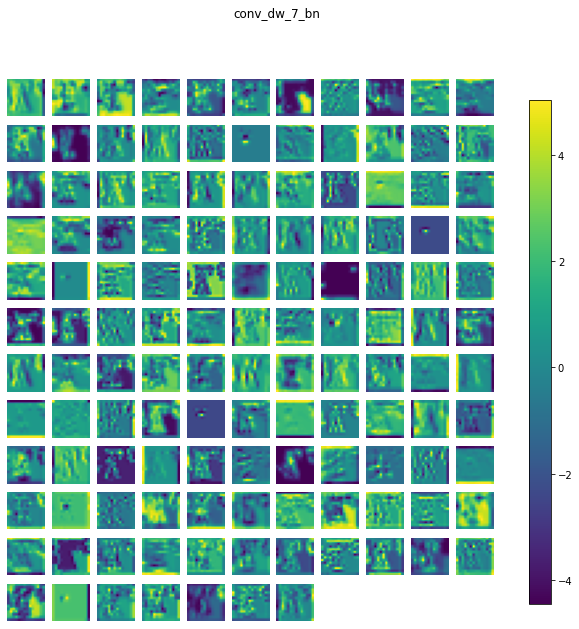

conv_dw_7_relu (1, 14, 14, 128) 


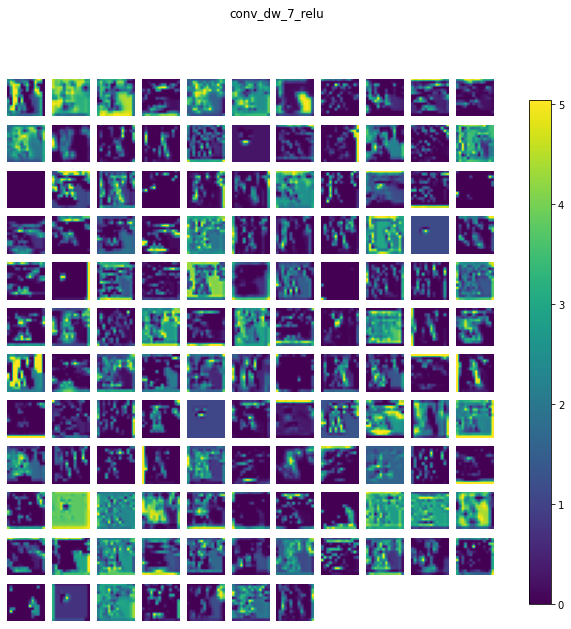

conv_pw_7 (1, 14, 14, 128) 


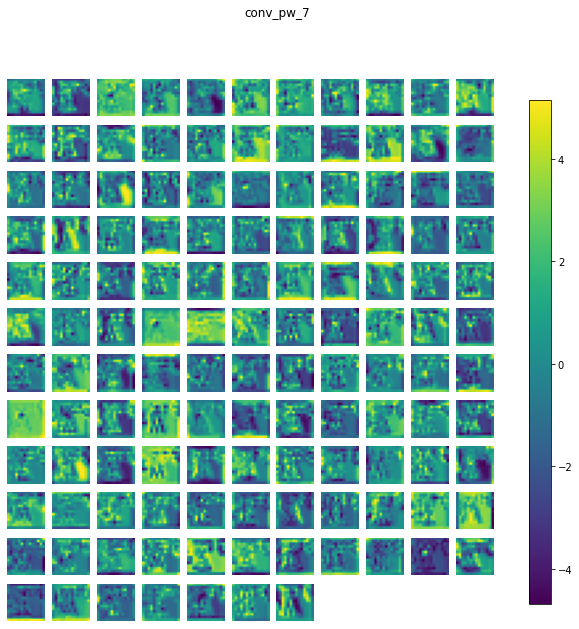

conv_pw_7_bn (1, 14, 14, 128) 


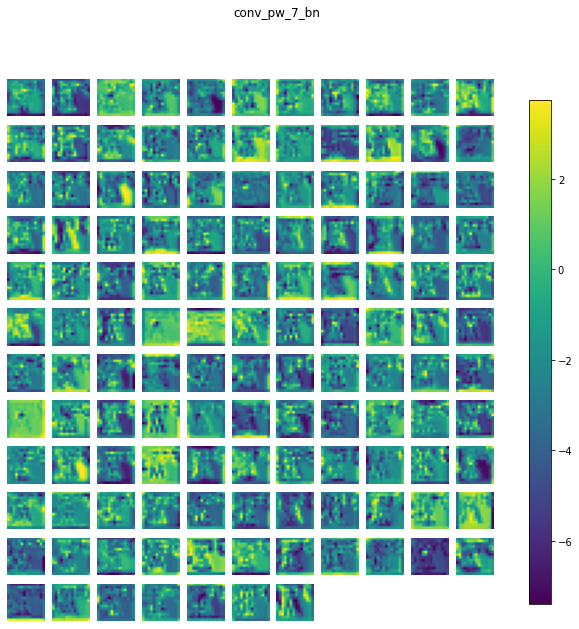

conv_pw_7_relu (1, 14, 14, 128) 


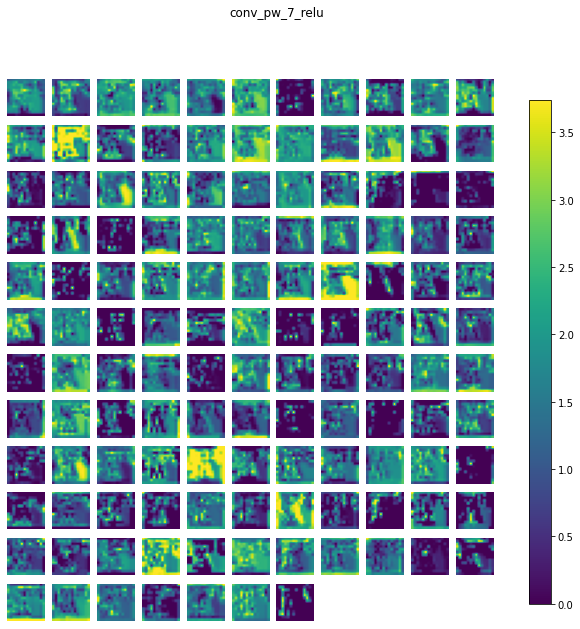

conv_dw_8 (1, 14, 14, 128) 


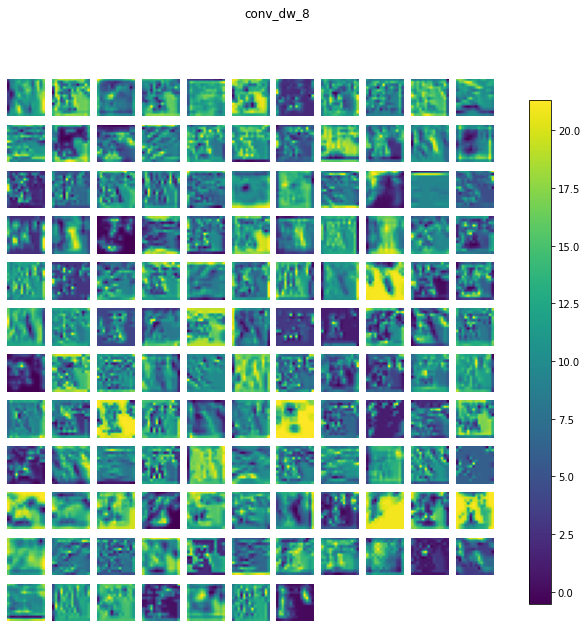

conv_dw_8_bn (1, 14, 14, 128) 


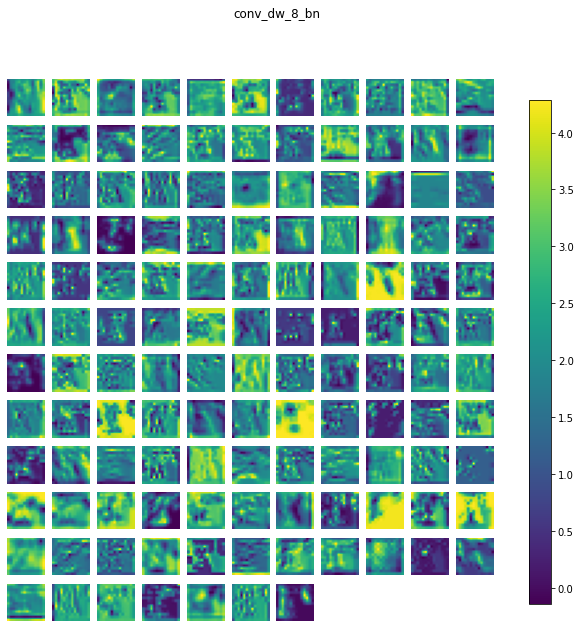

conv_dw_8_relu (1, 14, 14, 128) 


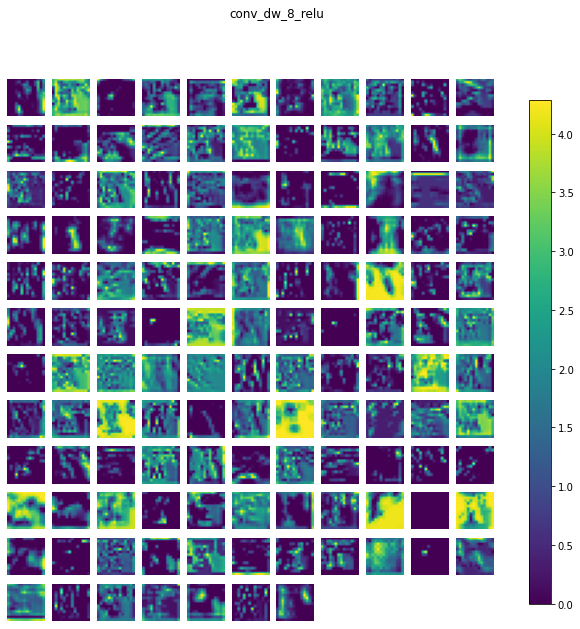

conv_pw_8 (1, 14, 14, 128) 


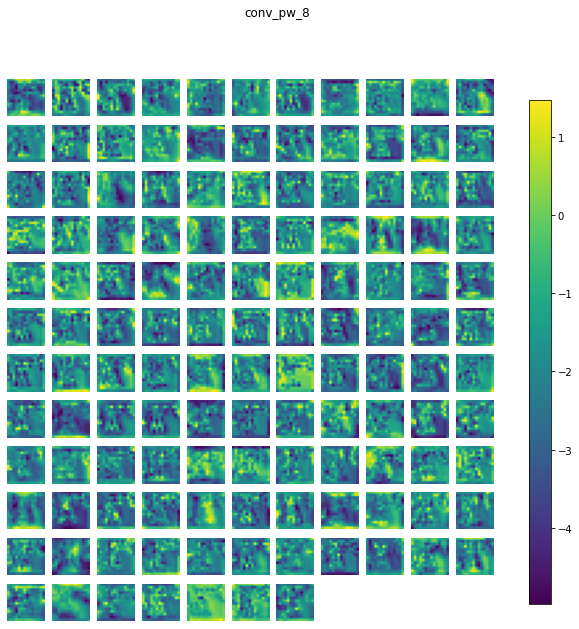

conv_pw_8_bn (1, 14, 14, 128) 


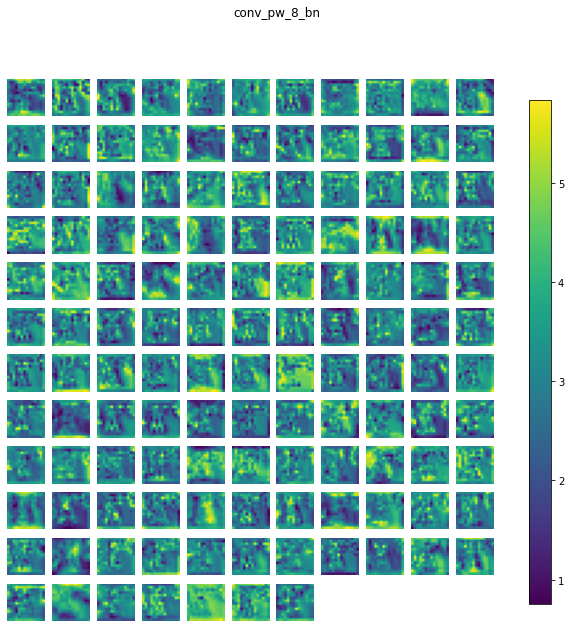

conv_pw_8_relu (1, 14, 14, 128) 


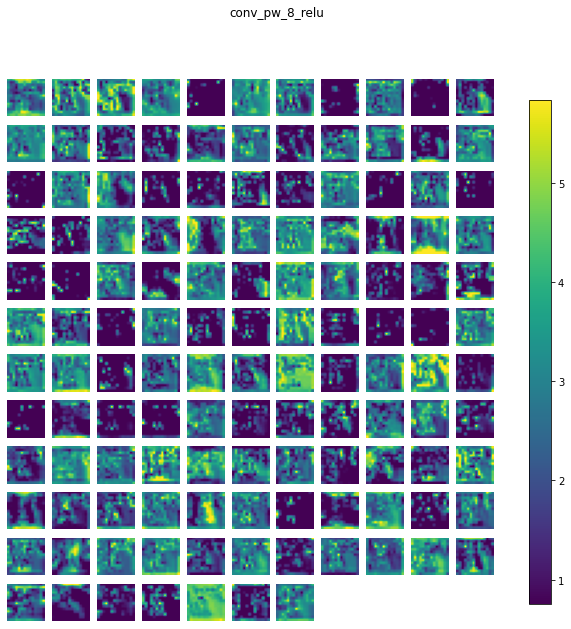

conv_dw_9 (1, 14, 14, 128) 


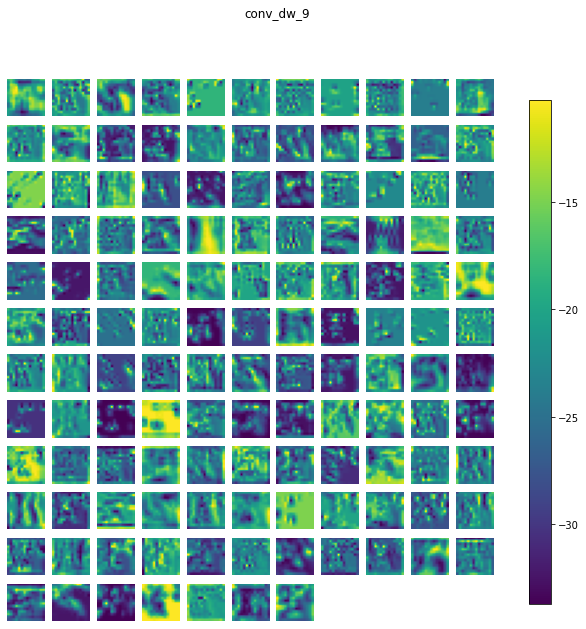

conv_dw_9_bn (1, 14, 14, 128) 


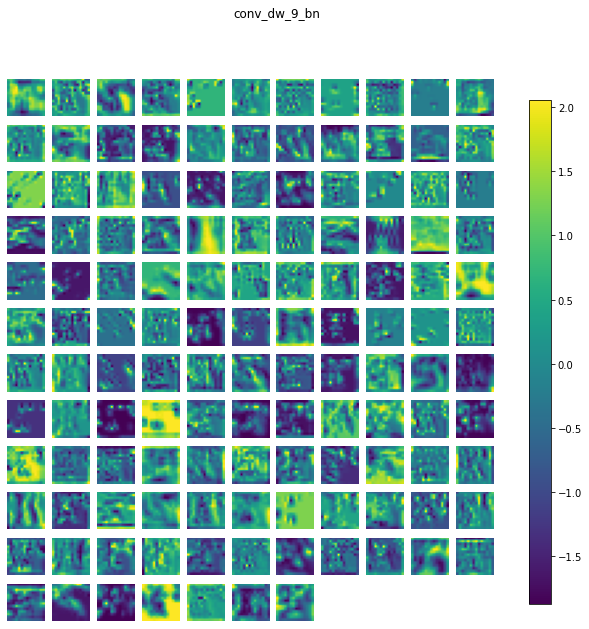

conv_dw_9_relu (1, 14, 14, 128) 


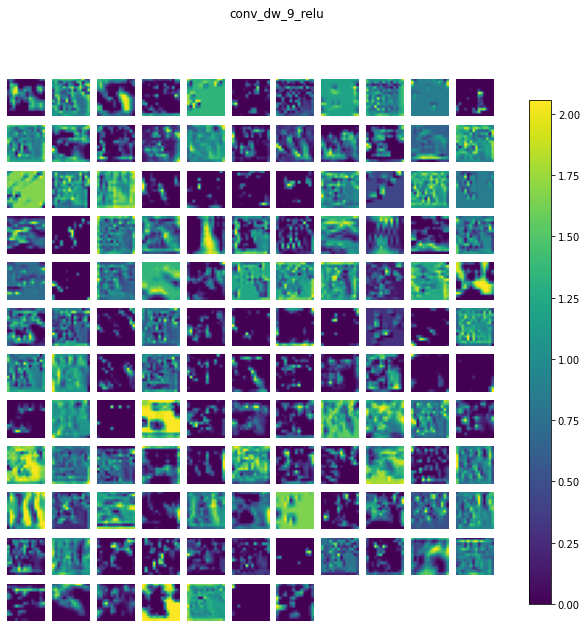

conv_pw_9 (1, 14, 14, 128) 


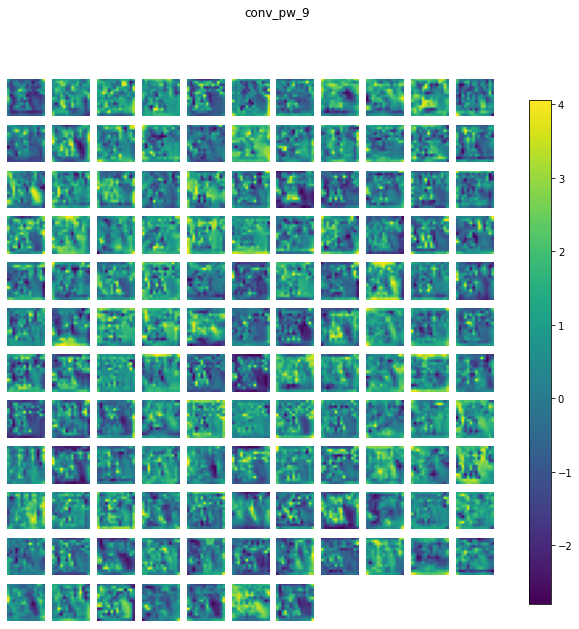

conv_pw_9_bn (1, 14, 14, 128) 


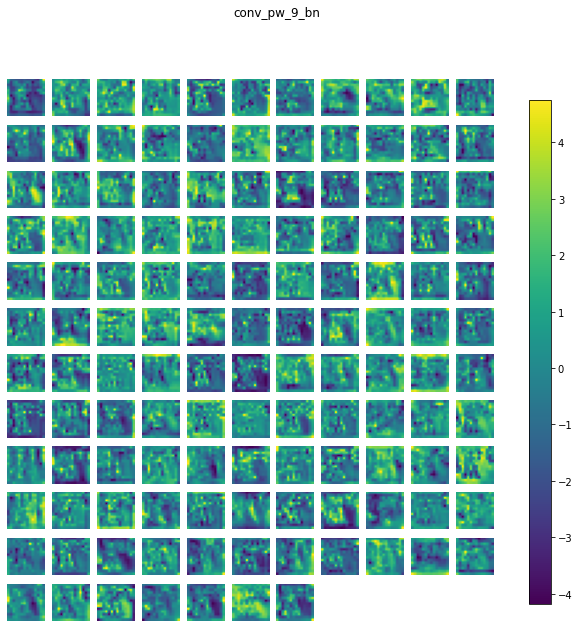

conv_pw_9_relu (1, 14, 14, 128) 


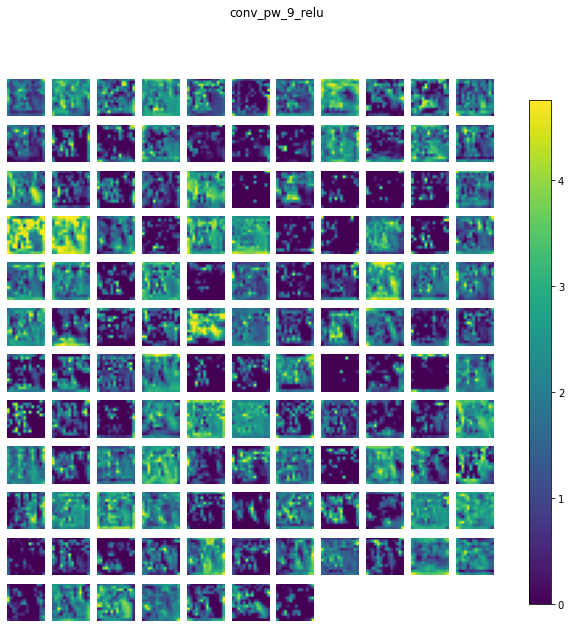

conv_dw_10 (1, 14, 14, 128) 


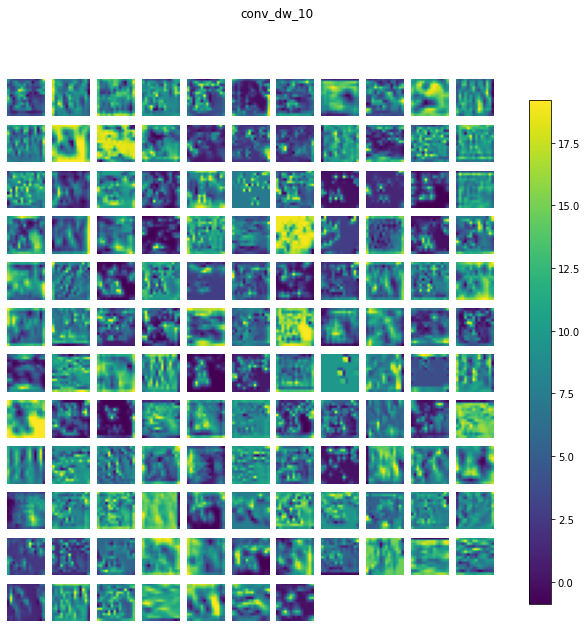

conv_dw_10_bn (1, 14, 14, 128) 


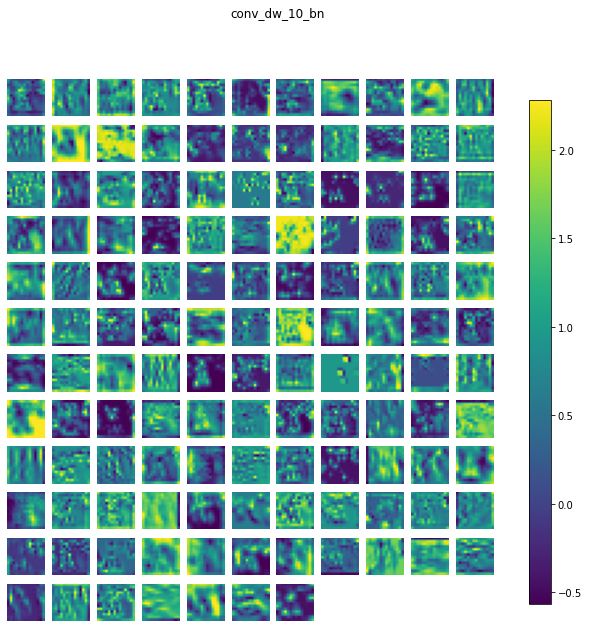

conv_dw_10_relu (1, 14, 14, 128) 


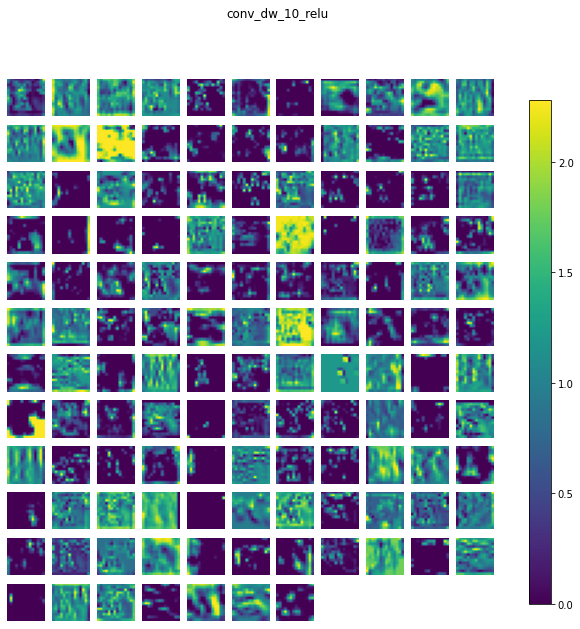

conv_pw_10 (1, 14, 14, 128) 


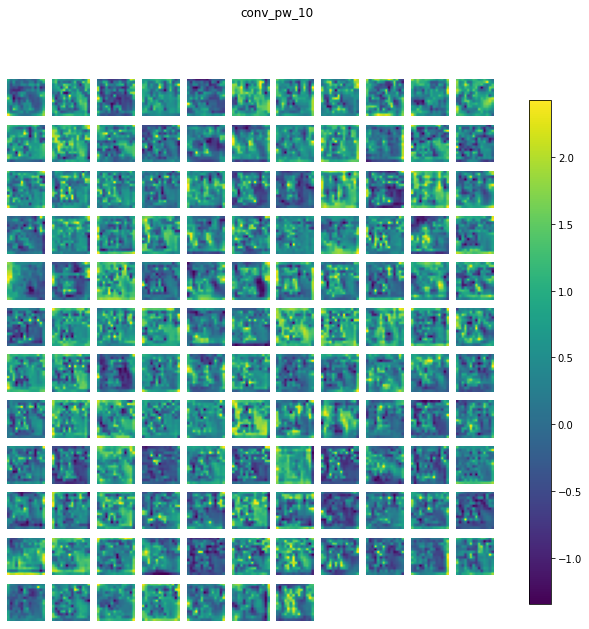

conv_pw_10_bn (1, 14, 14, 128) 


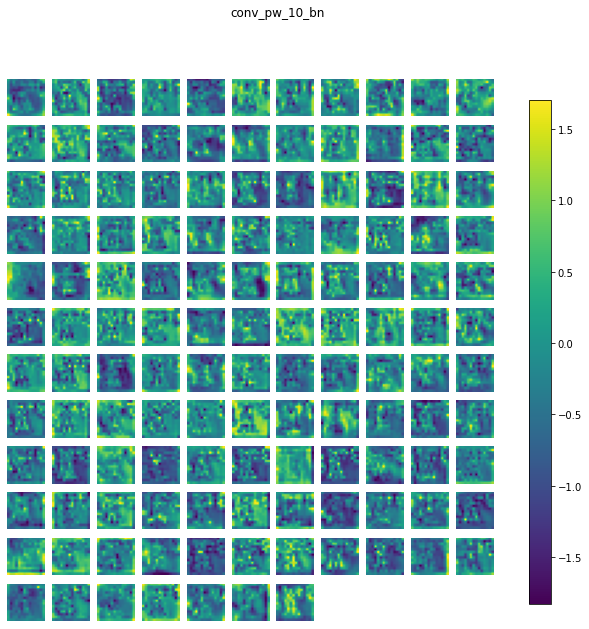

conv_pw_10_relu (1, 14, 14, 128) 


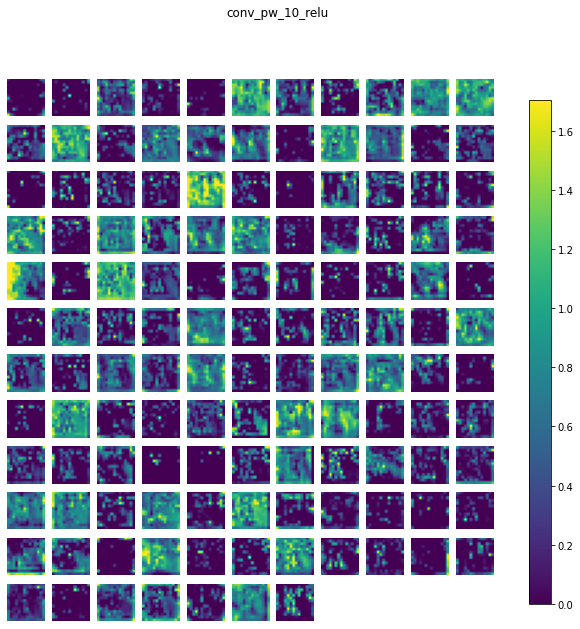

conv_dw_11 (1, 14, 14, 128) 


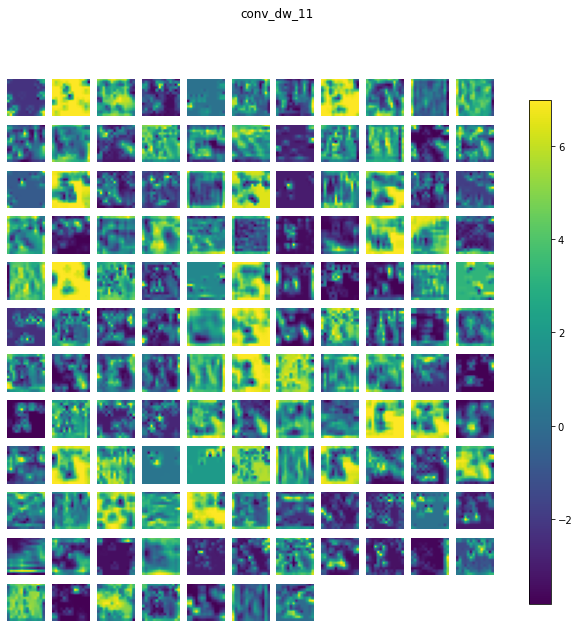

conv_dw_11_bn (1, 14, 14, 128) 


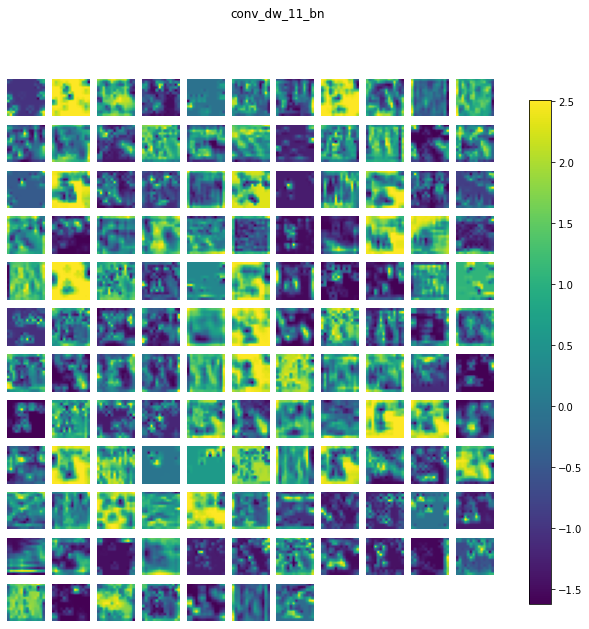

conv_dw_11_relu (1, 14, 14, 128) 


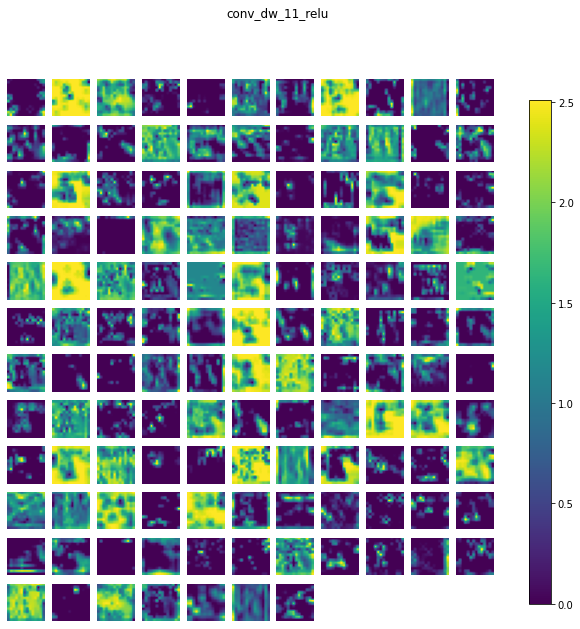

conv_pw_11 (1, 14, 14, 128) 


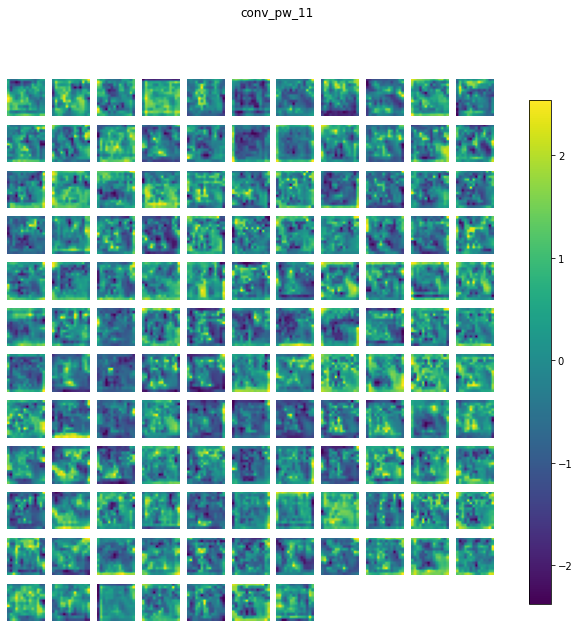

conv_pw_11_bn (1, 14, 14, 128) 


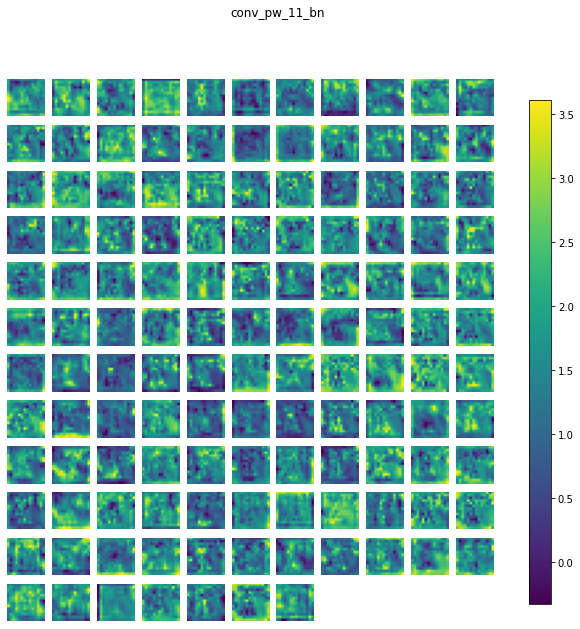

conv_pw_11_relu (1, 14, 14, 128) 


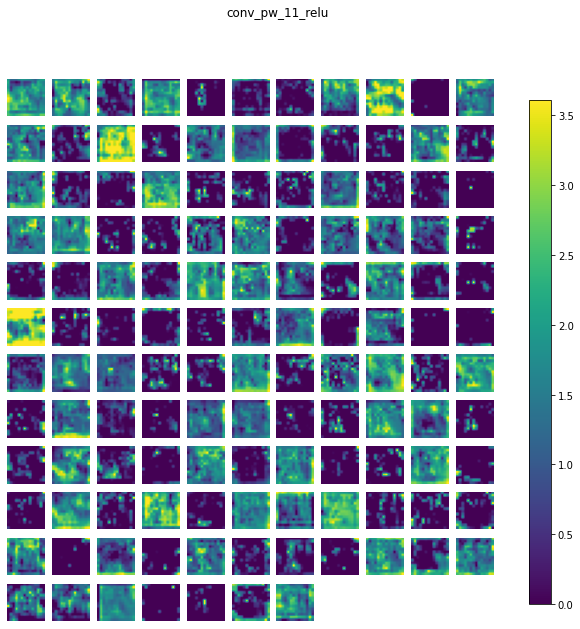

conv_pad_12 (1, 15, 15, 128) 


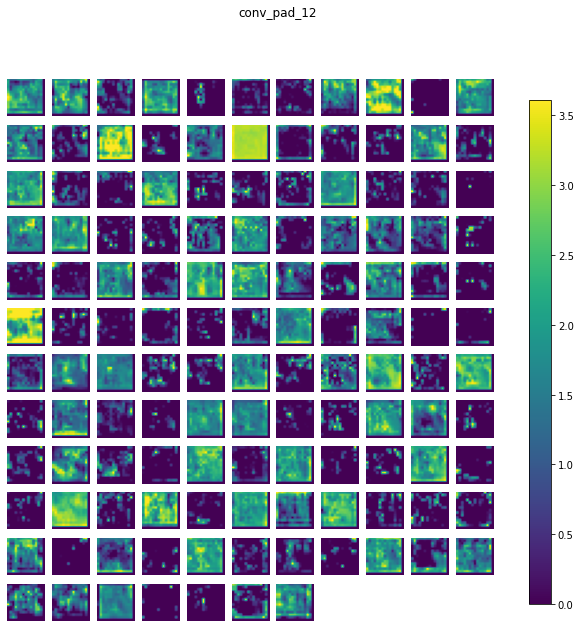

conv_dw_12 (1, 7, 7, 128) 


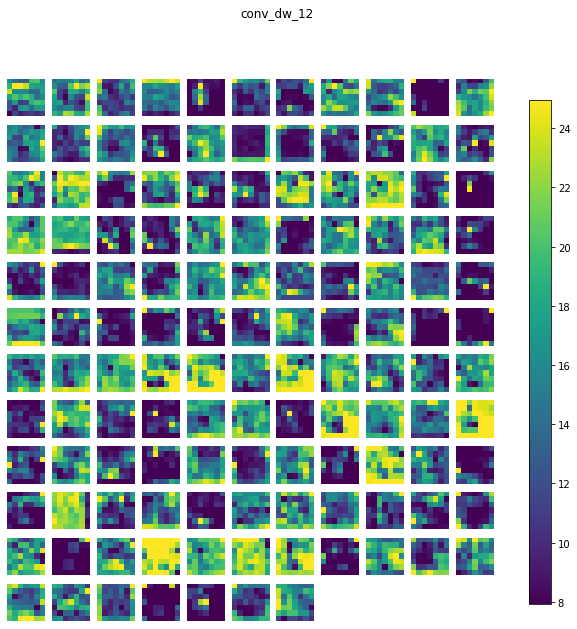

conv_dw_12_bn (1, 7, 7, 128) 


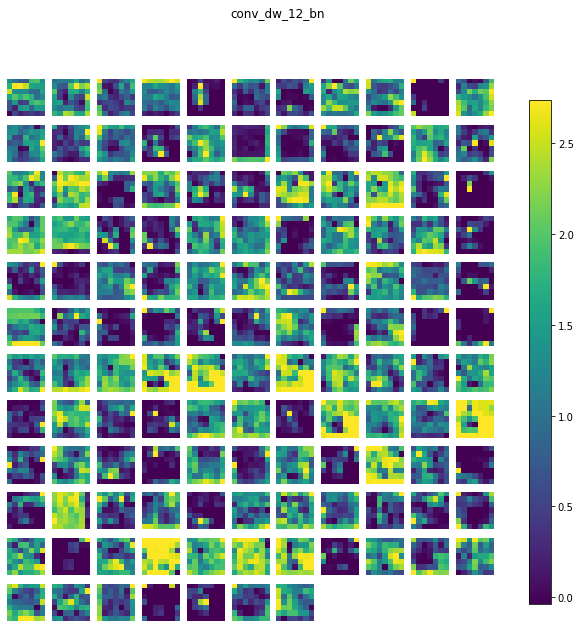

conv_dw_12_relu (1, 7, 7, 128) 


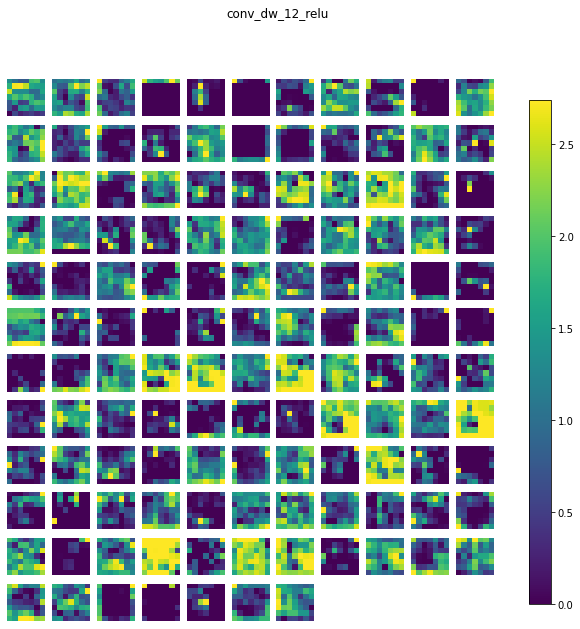

conv_pw_12 (1, 7, 7, 256) 


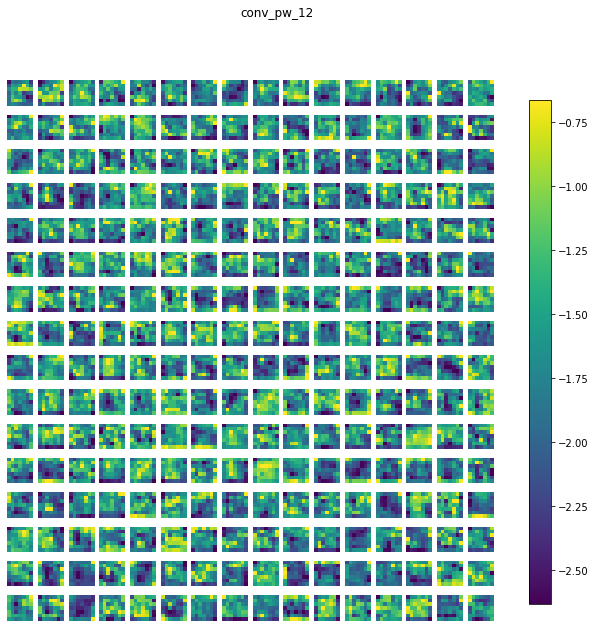

conv_pw_12_bn (1, 7, 7, 256) 


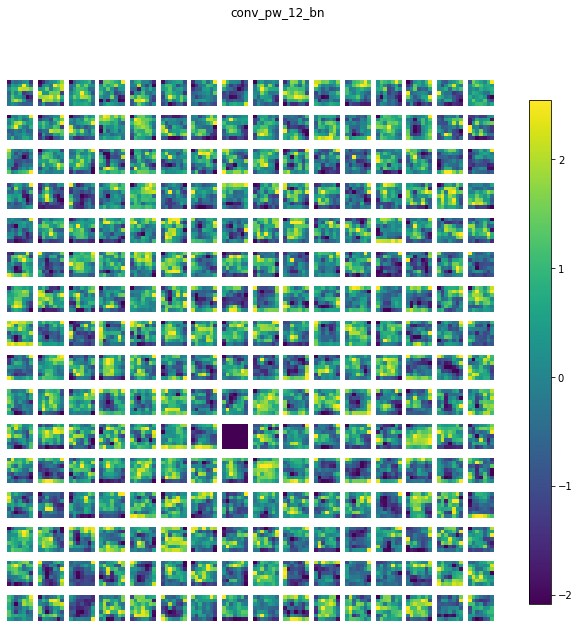

conv_pw_12_relu (1, 7, 7, 256) 


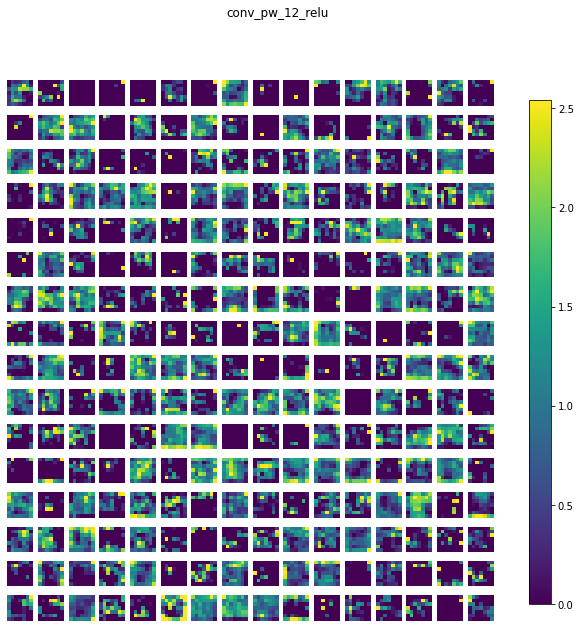

conv_dw_13 (1, 7, 7, 256) 


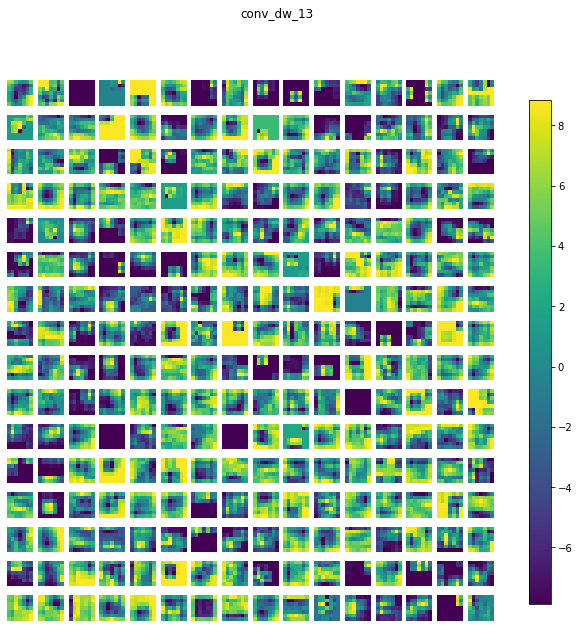

conv_dw_13_bn (1, 7, 7, 256) 


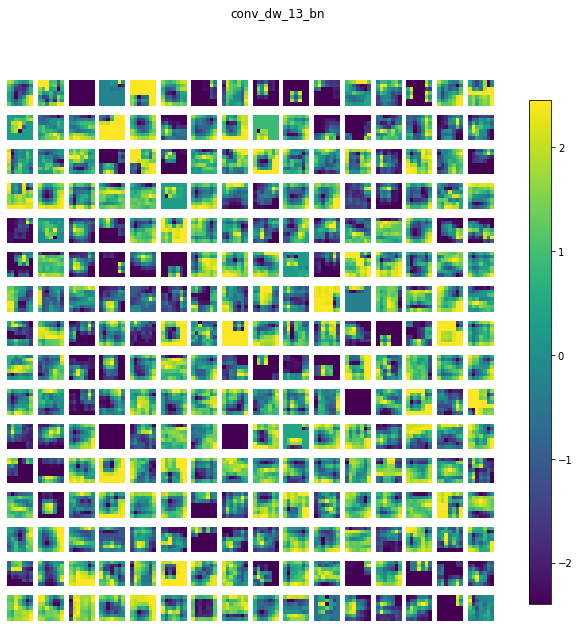

conv_dw_13_relu (1, 7, 7, 256) 


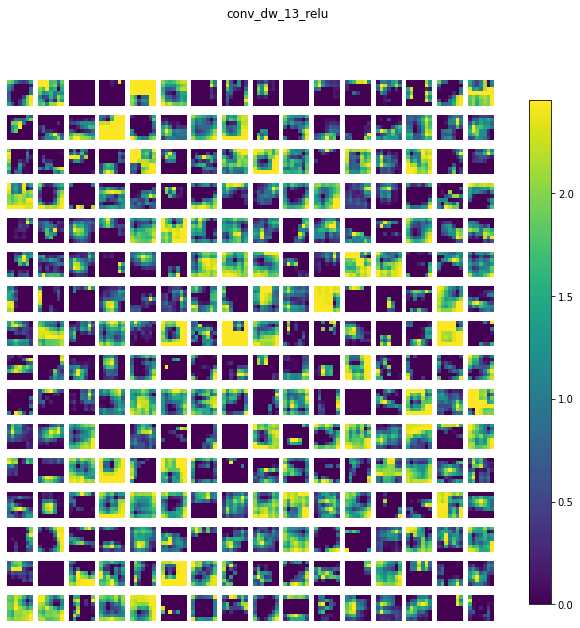

conv_pw_13 (1, 7, 7, 256) 


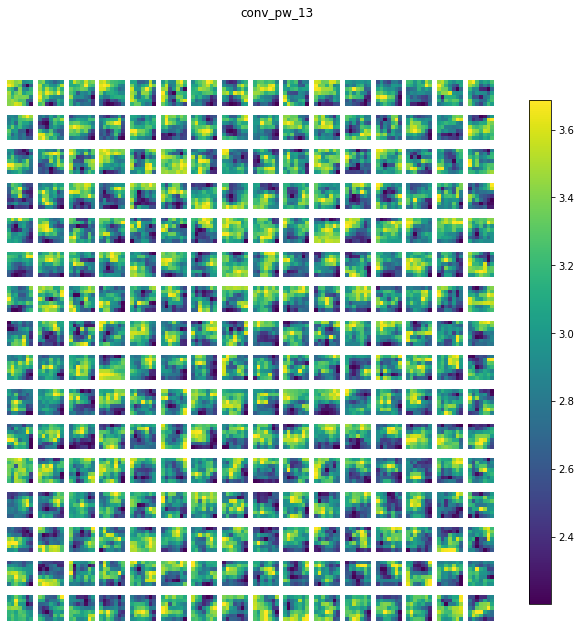

conv_pw_13_bn (1, 7, 7, 256) 


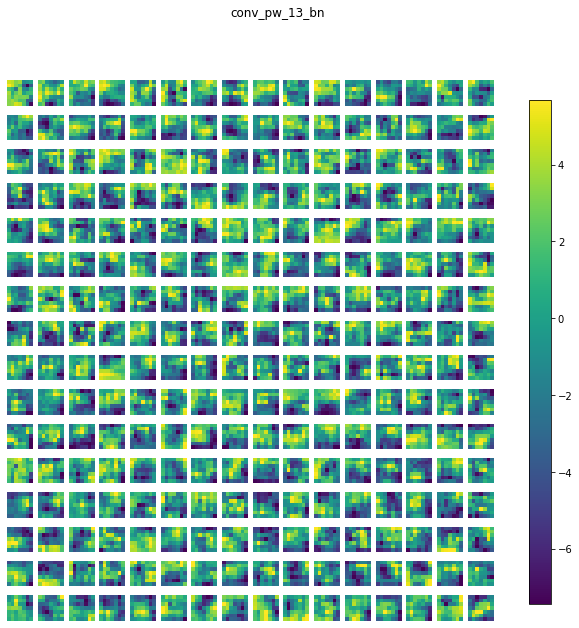

conv_pw_13_relu (1, 7, 7, 256) 


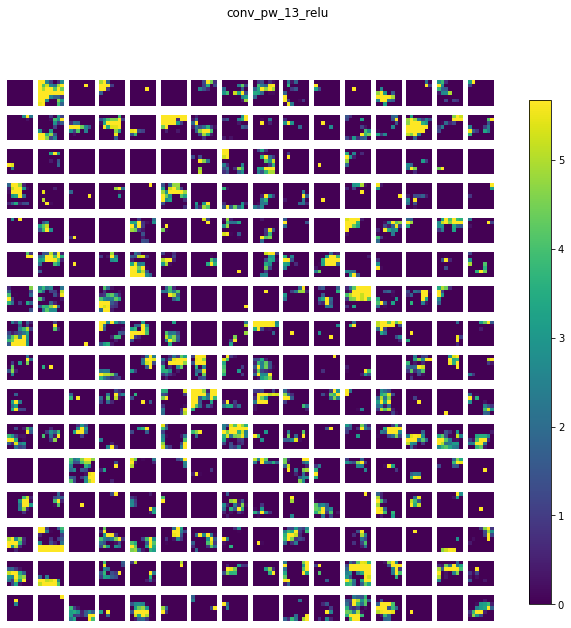

global_average_pooling2d (1, 1, 1, 256) 


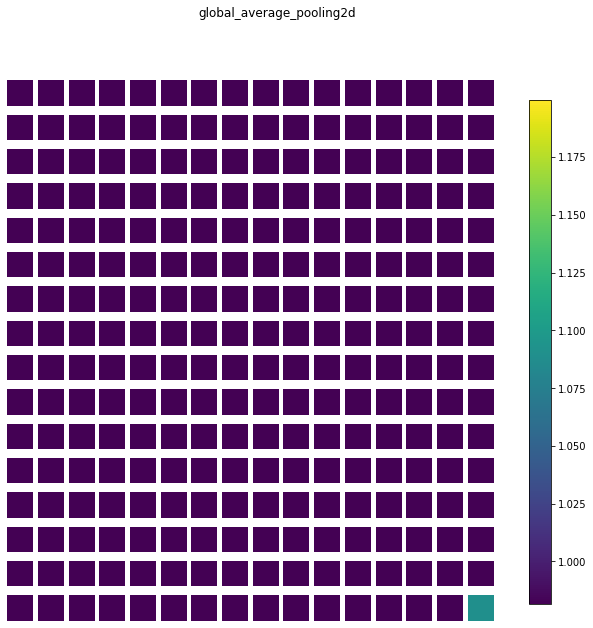

dropout (1, 1, 1, 256) 


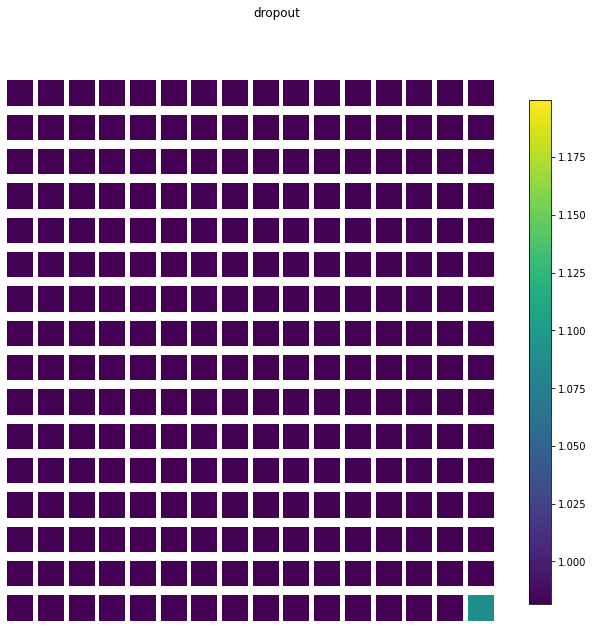

conv_preds (1, 1, 1, 1000) 


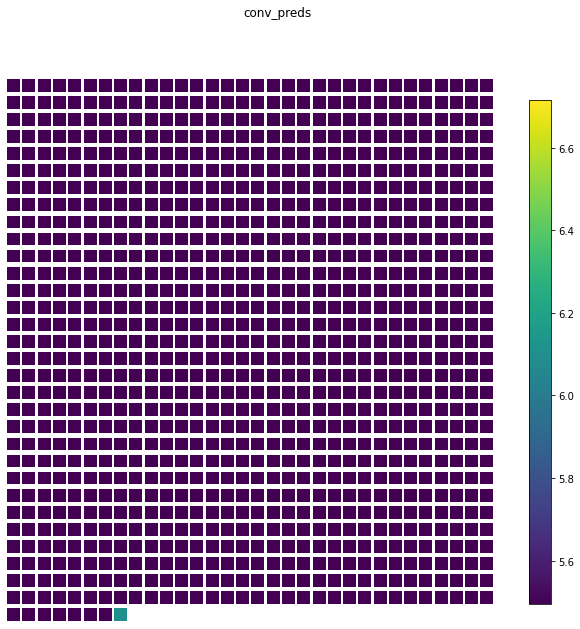

reshape_2 (1, 1000) 


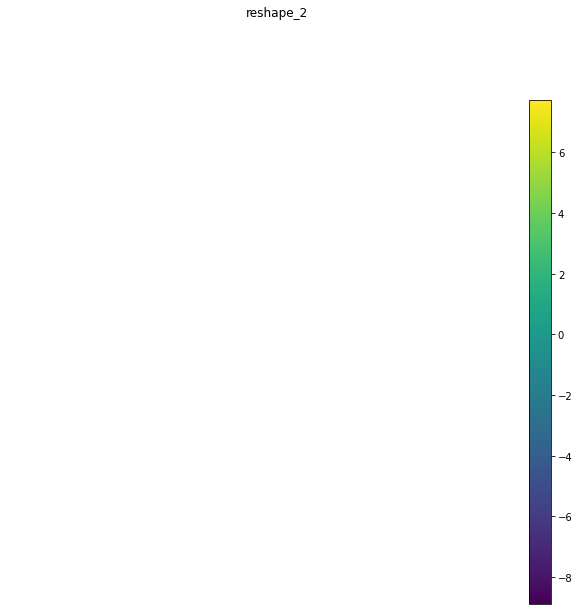

predictions (1, 1000) 


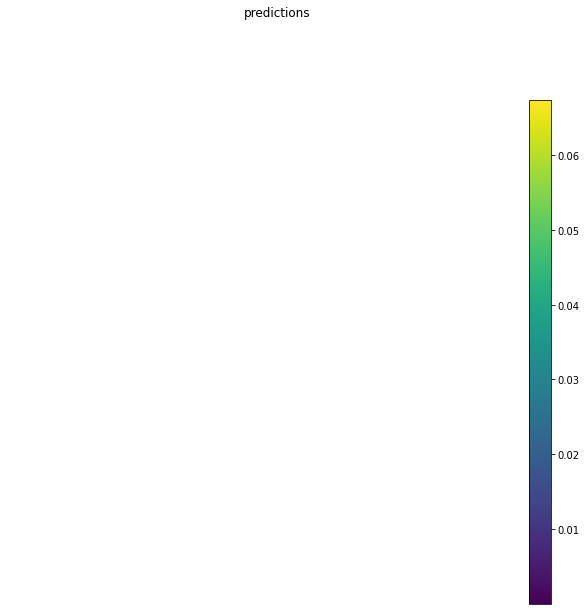

In [19]:
from keract import display_activations
display_activations(activations, save=False, fig_size=(10, 10))

In [20]:
# write your code
from keras.applications.vgg16 import VGG16
model = VGG16(weights='imagenet')
print(model.summary())

553476096/553467096 [==============================] - 4s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                            

In [27]:
features1 = model.predict(x)
print("\nFeatures shape: \n", features1.shape)
print("\nFeatures: \n", features1)


Features shape: 
 (1, 1000)

Features: 
 [[1.14405793e-07 1.70747307e-06 3.80370716e-06 1.79571623e-06
  2.66307961e-06 3.05315552e-07 3.21414397e-08 4.14928490e-06
  2.13593398e-06 2.44178250e-06 5.09053166e-07 2.57911609e-07
  9.38753431e-07 5.37470953e-07 2.64238139e-07 8.27291160e-07
  2.94156365e-07 1.68633942e-05 5.91627497e-07 6.46605145e-07
  7.55809481e-07 6.58282352e-06 3.73564518e-07 1.37256779e-06
  3.81908967e-06 4.61245776e-07 9.16460863e-07 4.59143564e-07
  1.60929960e-06 5.82512166e-06 1.71775213e-07 3.61522211e-07
  3.56169949e-07 4.71485578e-07 4.49673337e-07 1.61351878e-07
  4.71062867e-06 8.91857383e-07 2.40322825e-05 5.57708915e-07
  8.41006965e-07 3.86740021e-06 6.86239730e-07 2.97274028e-07
  2.11834322e-05 2.61590321e-06 3.99839610e-06 4.58065045e-07
  1.92568535e-07 3.09286833e-07 1.37450911e-06 2.04133403e-06
  1.80501002e-06 3.62928887e-07 3.36897210e-06 2.28673628e-07
  1.44899627e-06 2.56309733e-07 3.77148496e-07 1.95813391e-06
  7.16599243e-06 4.18191746e

In [28]:
p = decode_predictions(features1)
print(p)

[[('n02124075', 'Egyptian_cat', 0.8982449), ('n02123045', 'tabby', 0.032565877), ('n02123159', 'tiger_cat', 0.017709272), ('n02441942', 'weasel', 0.011910313), ('n02127052', 'lynx', 0.0048898547)]]


Problem 4- Store layer name in a list for the given pretrained network

In [31]:
## write your code here
model_minimal1 = Model(inputs=model.input, outputs=model.get_layer('input_2').output)

input_2_features = model_minimal1.predict(x)
print('Features of conv_dw_2_relu:',input_2_features.shape)

Features of conv_dw_2_relu: (1, 224, 224, 3)


In [48]:
print([layer.name for layer in model.layers])

['input_2', 'block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3', 'block5_pool', 'flatten', 'fc1', 'fc2', 'predictions']


Final Problem -  Develop a system for researcher where they get an option of available model(at least five) and layer no to extract the feature.

In [59]:
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [58]:
#write your code
model.layers